In [2]:
import scipy.io
import numpy as np
import scipy as sp
from scipy import signal
import cupy as cp
import matplotlib.pyplot as plt
import os
import time
#67135780

path = '/media/damian/8A4F-A24E/Results/'
#%matplotlib widget

# Tools

In [8]:
import math 

def getFmean(spectrum, fs):
    N = spectrum.shape[0]
    x_f = np.arange(0, N, 1)
    x_f = fs * x_f / N / 2
    
    #I = np.power(10, (spectrum / 20))
    I = spectrum
    
    Isum = np.sum(I)
    FI = np.sum(x_f * I)
    Fmean = FI / Isum
    return Fmean

# Power estimation
def getPwiTxEnergy(HV, Ncycles, Nframes, Nch, assym_factor, Cap):
    '''
    HV - HV voltage rail (single ended)
    Ncycles - number of cycles
    Nframes - number of frames
    Nch - number of tx channels
    assym_factor - number of insonifications for full aperture RX.
    Cap - capactiance of the transducer [F]
    '''

    NfullTransitions = 2 * Ncycles - 1
    NhalfTransitions = 1
    
    E1 = 0.5 * Cap * (2 * HV) * (2 * HV) * NfullTransitions
    E2 = 0.5 * Cap * (HV * HV) * NhalfTransitions
    E = (E1 + E2) * Nch * Nframes * assym_factor
    return E

def getPushTxEnergy(HV, Length, f, Nch, Cap):
    '''
    HV - HV voltage rail (single ended)
    Length - push duration [us]
    f - push frequency [MHz]
    Nch - number of tx channels
    Cap - capactiance of the transducer [F]
    '''

    Ncycles = Length * f
    NfullTransitions = 2 * Ncycles - 1
    NhalfTransitions = 1
    
    E1 = 0.5 * Cap * (2 * HV) * (2 * HV) * NfullTransitions
    E2 = 0.5 * Cap * (HV * HV) * NhalfTransitions
    E = (E1 + E2) * Nch
    return E

OEM_TYPE = 'OEM+'
def getTxFreq(TxFreq):
    '''
    Input parameters:
    TxFreq: desired output frequency in [MHz]
    
    Returns: (ClosestTxFreq, ClosestTxFreq_Alternative)
    f1: possible output frequency [MHz], closest to desired
    f2: second closest possible output frequency [MHz].
    '''
    if(OEM_TYPE == 'OEM'):
        txClk = 130.0
    elif(OEM_TYPE == 'OEM+'):
        txClk = 195.0
     
    req_period_ns = 1000.0 / TxFreq
    clk_period_ns = 1000.0 / txClk
    
    hcCks0 = math.ceil(req_period_ns / clk_period_ns / 2)
    hcCks1 = math.floor(req_period_ns / clk_period_ns / 2)
    
    if(OEM_TYPE == 'OEM'):
        if(hcCks0 < 1):
            hcCks0 = 1
        elif(hcCks0 > 64):
            print('Requested frequency is below possible range. Returning minimum possible.')
            hcCks0 = 64
       
        if(hcCks1 < 1):
            hcCks1 = 1
        elif(hcCks1 > 64):
            hcCks1 = 64    
        
    elif(OEM_TYPE == 'OEM+'):
        if(hcCks0 < 2):
            hcCks0 = 2

        if(hcCks1 < 2):
            hcCks1 = 2         
    
    f1 = 1000.0 / (hcCks0 * 2 * clk_period_ns )
    f2 = 1000.0 / (hcCks1 * 2 * clk_period_ns )
    
    if(abs(f1-TxFreq) < abs(f2-TxFreq)):
        return (f1, f2) 
    else:
        return (f2, f1)
    
## Get temporal frequency spectrum
def SW_spectralAnalysis_Temporal(data, Fs, NFFT):

    # Apply window function
    N = data.shape[2]
    w = sp.signal.windows.tukey(N, alpha=0.2, sym=True)
    data_w = data * w

    # Do fft
    Hy = sp.fft.fft(data_w, NFFT)
    P2 = np.abs(Hy/NFFT)
    P1 = P2[:, :, 1:NFFT//2+1]
    P1[:, :, 1:-1] = 2*P1[:, :, 1:-1]

    # Average
    Pmean = np.mean(P1, axis=0)
    Pmean = np.mean(Pmean, axis=0)
    return Pmean

    #Plot
    #x_f = np.arange(0, NFFT//2, 1)
    #x_f = Fs*x_f/NFFT

    #M = np.max(Pmean)
    #Xn = Pmean/M
    #Pmean_dB = 20 * np.log10(Xn)
    #fig, ax = plt.subplots(1, 1, figsize=(8, 4))
    #ax.plot(x_f, Pmean_dB+3.5)
    return    

pwi_E  = getPwiTxEnergy(HV=100, Ncycles=3, Nframes=100, Nch=128, assym_factor=2, Cap=200e-12)
push_E = getPushTxEnergy(HV=100, Length=500, f=4.4, Nch=48, Cap=200e-12) 
print(pwi_E)
print(push_E)

0.5376
0.8446560000000001


In [8]:
f = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.4, 5.6, 5.8, 6.0]
freal = [0] * len(f)
for i in range(len(f)):
    (f1, f2) = getTxFreq(f[i])
    freal[i] = f1
print(f)    
print(freal)

[4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.4, 5.6, 5.8, 6.0]
[4.062499999999999, 4.239130434782608, 4.431818181818182, 4.642857142857142, 4.875, 4.875, 5.13157894736842, 5.416666666666666, 5.735294117647059, 5.735294117647059, 6.093749999999999]


(200, 251)
(200, 251)


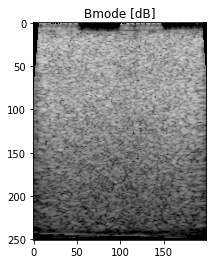

In [2]:
data = sp.io.loadmat(path + "Test_1/a/bmode_freq4.4_cycles2_pri100.0_id_0.mat")
lri= data["data"]
print(lri.shape)
#lri = lri[5, :, :]
print(lri.shape)
lri = np.squeeze(lri)

if(1):
    #hri = np.mean(a=lri, axis=0)
    #hri = np.squeeze(lri[41, :, :])
    hri = lri

    # Envelope detection
    data = np.abs(hri)
    # Log compression
    data[data==0] = 10**-10
    data = 20 * np.log10(data)

    data_dim = data.shape
    if(data_dim[1] > data_dim[0] ):
        data = np.transpose(data, [1,0])

    dB_range = [20, 84] 
    norm = plt.Normalize(dB_range[0], dB_range[1], True)
    fig, ax0 = plt.subplots(1, 1, figsize=(8, 4))
    #%matplotlib widget
    ax0.imshow(data, cmap='gray', norm=norm)
    ax0.set_title('Bmode [dB]')

# Test 1

## Test 1a

(250, 200, 145)
(220, 200, 145)
(145, 220, 200)
(220, 200, 145)
(220, 200)


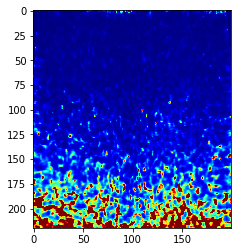

In [33]:
# Check if energy maps calculated properly (debug)
data = sp.io.loadmat(path + "/Test_1/a/swd_freq4.4_cycles2_pri100.0_id_0.mat")
ddata_cpu= data["data"]
print(ddata_cpu.shape)

## Get energy map
ddataE = np.squeeze(ddata_cpu[10:-20, ...])
print(ddataE.shape)

# Get avarage and delete it
m = np.mean(ddataE, axis=2)
ddataE = np.transpose(ddataE, [2,0,1])
print(ddataE.shape)
ddataE = np.subtract(ddataE, m)
ddataE = np.transpose(ddataE, [1,2,0])
print(ddataE.shape)
E = np.power(ddataE, 2)
E = np.squeeze(np.sum(E, 2))
#E = np.sqrt(E)

norm = plt.Normalize(0, 1e-5, True)
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
print(E.shape)
ax.imshow(E, cmap='jet', norm=norm)


Text(0, 0.5, 'Noise energy [a.u]')

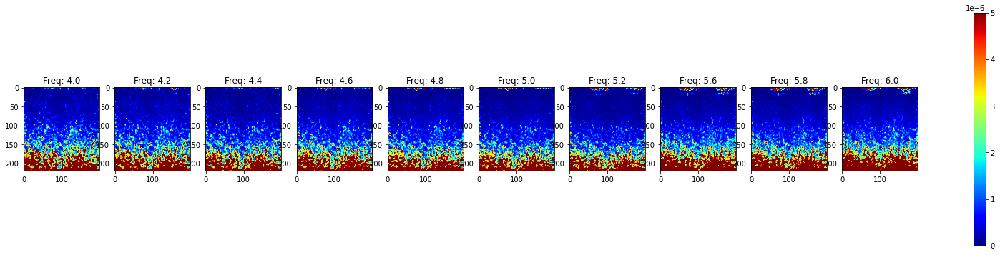

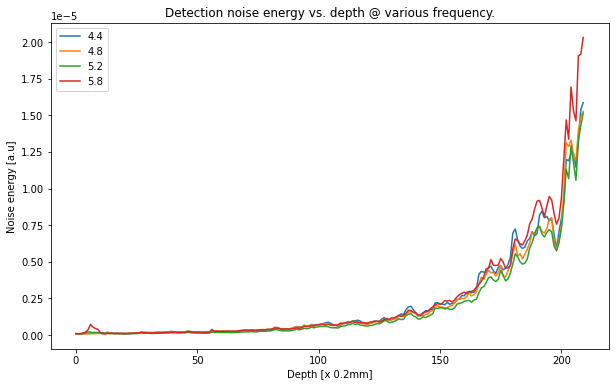

In [44]:
# Test 1a
freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.6, 5.8, 6.0]
datatype = 'swd'

# Correct frequencies
freal = [0] * len(freq)
for i in range(len(freq)):
    (f1, f2) = getTxFreq(freq[i])
    freal[i] = f1

# Load data
data = []
for i in freq:
    dataset = sp.io.loadmat(path + '/Test_1/a/energy_' + datatype + '_freq' + str(i) + '_cycles2_pri100.0_id_0.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(len(freq)):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    #d[d==0] = 1e-12
    #d = 20 * np.log10(d)
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 0.5e-5, True)
ax = [] * len(freq)
fig, ax = plt.subplots(1, len(freq), figsize=(28, 6))
for i in range(len(freq)):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('Freq: ' + str(freq[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(10, 6))
profiles = [2, 4, 6, 8]
for i in profiles:
    ax2.plot(p[i][10:], label=str(freq[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ various frequency.')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')


## Test 1b



Text(0, 0.5, 'Noise energy [a.u]')

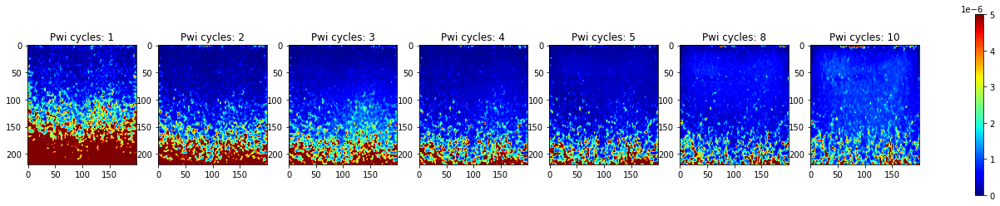

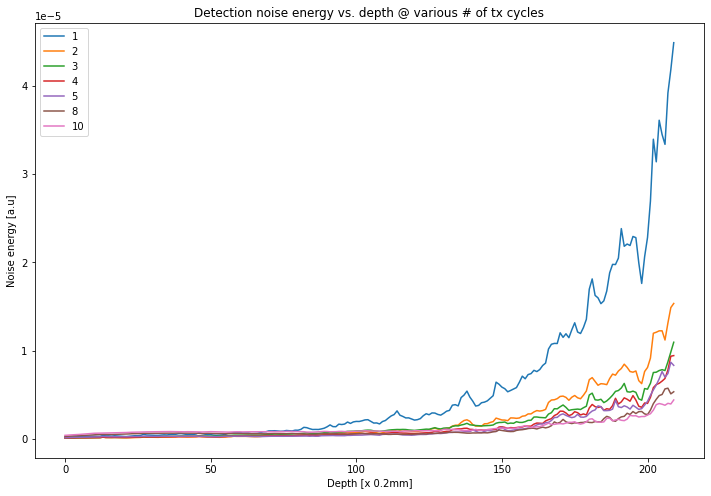

In [52]:
# Test 1a
cycles = [1,2,3,4,5,8,10]
datatype = 'swd'

# Load data
data = []
for i in cycles:
    dataset = sp.io.loadmat(path + 'Test_1/b/energy_' + datatype + '_freq4.4'+ '_cycles' + str(i)+'_pri100.0_id_0.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(len(cycles)):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 0.5e-5, True)
ax = [] * len(cycles)
fig, ax = plt.subplots(1, len(cycles), figsize=(24, 4))
for i in range(len(cycles)):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('Pwi cycles: ' + str(cycles[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(12, 8))
profiles = [0, 1, 2, 3, 4, 5, 6]
for i in profiles:
    ax2.plot(p[i][10:], label=str(cycles[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ various # of tx cycles')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1c

Text(0, 0.5, 'Noise energy [a.u]')

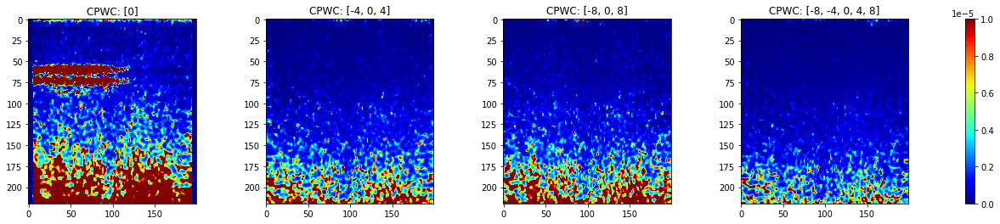

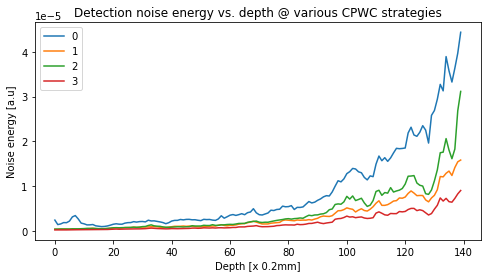

In [54]:
# Test 1a
idx = [0, 1, 2, 3]
mode = ['[0]', '[-4, 0, 4]', '[-8, 0, 8]', '[-8, -4, 0, 4, 8]']
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/c/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(len(idx)):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * len(idx)
fig, ax = plt.subplots(1, len(idx), figsize=(24, 4))
for i in range(len(idx)):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('CPWC: ' + mode[i])
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in idx:
    ax2.plot(p[i][80:], label=str(idx[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ various CPWC strategies')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1d

Text(0, 0.5, 'Noise energy [a.u]')

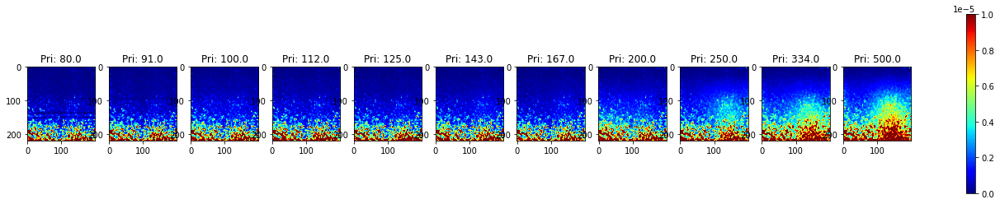

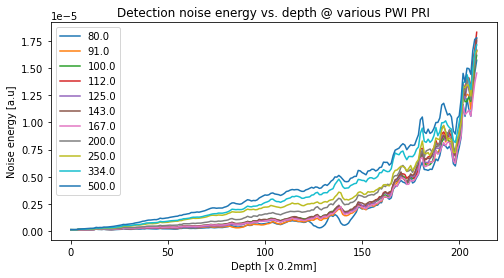

In [56]:
pri = [80.0, 91.0, 100.0, 112.0, 125.0, 143.0, 167.0, 200.0, 250.0, 334.0, 500.0]
N = len(pri)
datatype = 'swd'

# Load data
data = []
for i in pri:
    dataset = sp.io.loadmat(path + 'Test_1/d/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri' + str(i) + '_id_0.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('Pri: ' + str(pri[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(pri[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ various PWI PRI')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1e

Text(0, 0.5, 'Noise energy [a.u]')

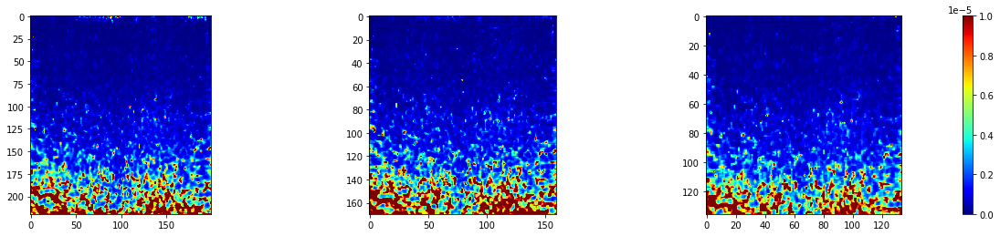

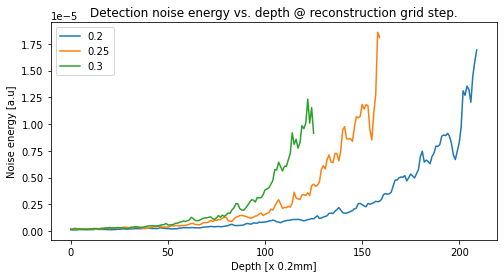

In [57]:
idx = [2,3,4]
grid_size = [0.2, 0.25, 0.3]
N = len(idx)
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/e/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0' + '_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    #ax[i].set_title('Pri: ' + str(idx[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(grid_size[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ reconstruction grid step.')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1f


Text(0, 0.5, 'Noise energy [a.u]')

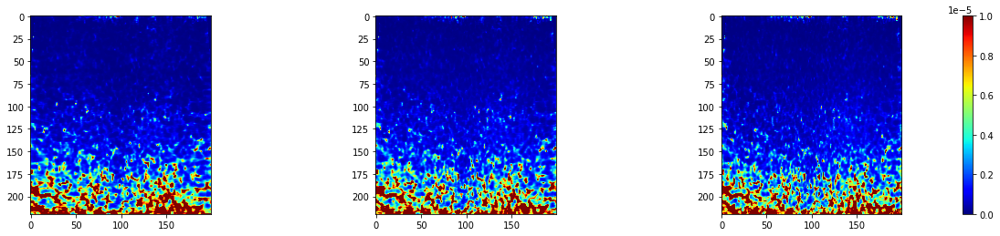

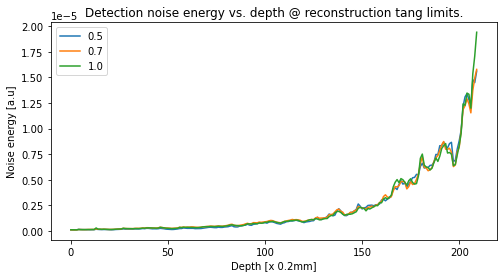

In [58]:
idx = [0,1,2]
tang_limits = [0.5, 0.7, 1.0]
N = len(idx)
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/f/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0' + '_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    #ax[i].set_title('Pri: ' + str(idx[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(tang_limits[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ reconstruction tang limits.')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1g

Text(0, 0.5, 'Noise energy [a.u]')

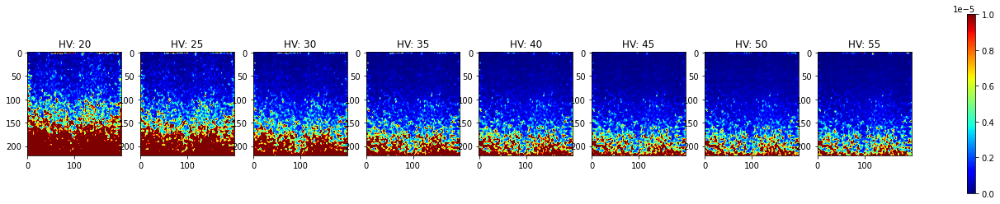

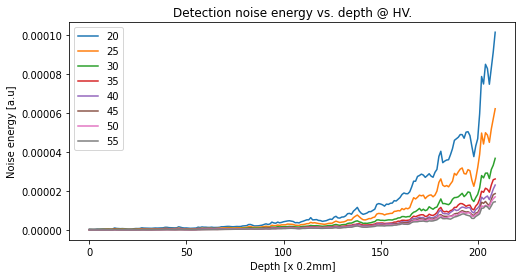

In [61]:
idx = [0, 1, 3, 4, 5, 6, 7, 8]
hv = [20, 25, 30, 35, 40, 45, 50, 55, 60]
N = len(idx)
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/g/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0' + '_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('HV: ' + str(hv[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(hv[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ HV.')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1h

Text(0, 0.5, 'Noise energy [a.u]')

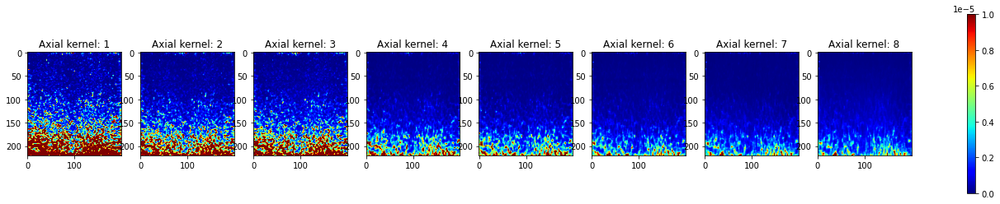

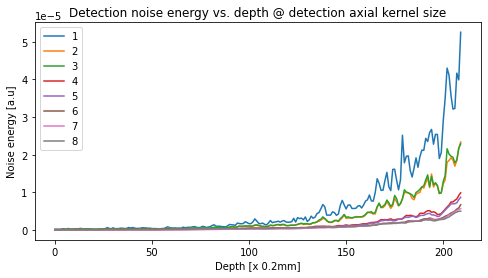

In [64]:
idx = [1, 3, 4, 5, 6, 7, 8, 9]
axial_kernel = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
N = len(idx)
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/h/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0' + '_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('Axial kernel: ' + str(axial_kernel[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(axial_kernel[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ detection axial kernel size')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

## Test 1i

Text(0, 0.5, 'Noise energy [a.u]')

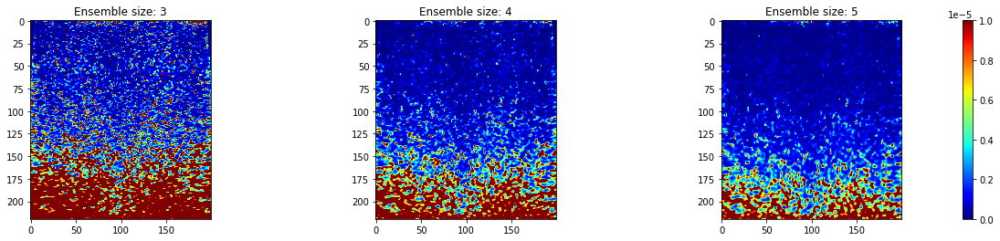

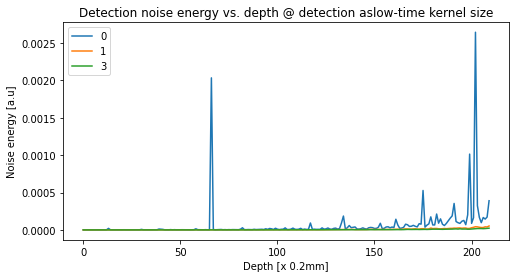

In [65]:
idx = [0, 1, 3]
ensemble_size = [3, 4, 5, 6]
N = len(idx)
datatype = 'swd'

# Load data
data = []
for i in idx:
    dataset = sp.io.loadmat(path + 'Test_1/h/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri100.0' + '_id_' + str(i) + '.mat')
    din = dataset["data"]                        
    data.append(din)                        
      
# Process data
p = []
for i in range(N):
    d = data[i]
    profile = np.squeeze(np.mean(d, 1))
    data[i] = d
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 1e-5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(data[i], cmap='jet', norm=norm)
    ax[i].set_title('Ensemble size: ' + str(ensemble_size[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i][10:], label=str(idx[i]))

ax2.legend()
ax2.set_title('Detection noise energy vs. depth @ detection aslow-time kernel size')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

# Test 2

## Test 2a

Text(0, 0.5, 'Noise energy [a.u]')

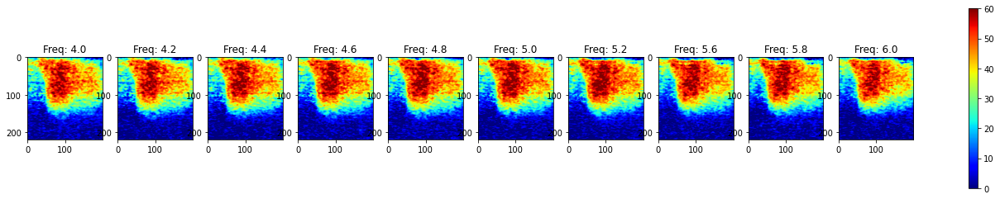

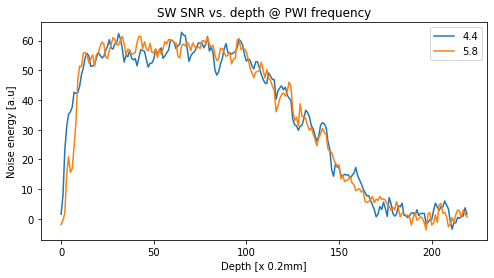

In [71]:
### SNR map ###
freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.6, 5.8, 6.0]
datatype = 'swdf'
N = len(freq)

# Correct frequencies
freal = [0] * len(freq)
for i in range(len(freq)):
    (f1, f2) = getTxFreq(freq[i])
    freal[i] = f1

# Load data
dataSW = []
dataEmpty = []

for i in freq:
    dataset = sp.io.loadmat(path + '/Test_2/a/energy_' + datatype + '_freq' + str(i) + '_cycles2_pri100.0_id_0.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in freq:
    dataset = sp.io.loadmat(path + '/Test_1/a/energy_' + datatype + '_freq' + str(i) + '_cycles2_pri100.0_id_0.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 60, True)
ax = [] * len(freq)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('Freq: ' + str(freq[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
profiles = [2, 8]
for i in profiles:
    ax2.plot(p[i], label=str(freq[i]))

ax2.legend()
ax2.set_title('SW SNR vs. depth @ PWI frequency')
ax2.set_xlabel('Depth [x 0.2mm]')
ax2.set_ylabel('Noise energy [a.u]')

Text(0, 0.5, 'Normalized energy [dB]')

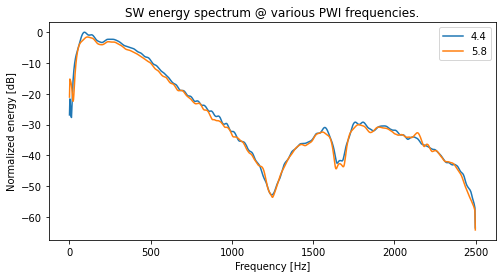

In [68]:
### Spectral analysis ###
freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.6, 5.8, 6.0]
datatype = 'swd'
N = len(freq)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + '/Test_2/a/swd' + '_freq' + str(freq[i]) + '_cycles2_pri100.0_id_0.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT

        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
profiles = [2, 8]
for i in profiles:
    ax.plot(x_f, spec[i], label=str(freq[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various PWI frequencies.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std dev. [m/s]')

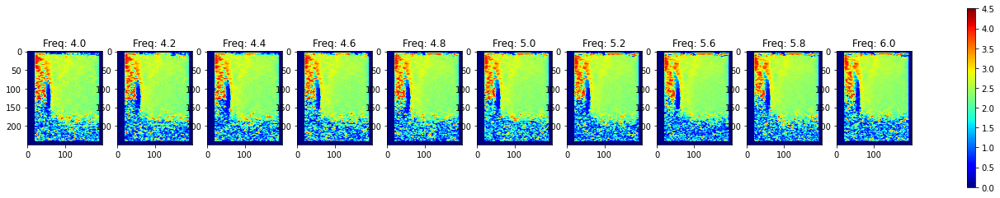

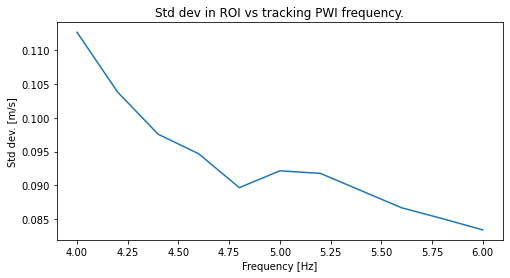

In [75]:
### SWS map variance analysis ###
freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.6, 5.8, 6.0]
N = len(freq)

# Load data
dataSWS = []

for i in freq:
    dataset = sp.io.loadmat(path + '/Test_2/a/sws' + '_freq' + str(i) + '_cycles2_pri100.0_id_0.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * len(freq)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Freq: ' + str(freq[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plotZrzut ekranu z 2023-03-16 21-25-54
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(freq, var)
ax.set_title('Std dev in ROI vs tracking PWI frequency.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Std dev. [m/s]')


In [72]:
print(freal)

[4.062499999999999, 4.239130434782608, 4.431818181818182, 4.642857142857142, 4.875, 4.875, 5.13157894736842, 5.735294117647059, 5.735294117647059, 6.093749999999999]


## Test 2b

Text(0, 0.5, 'Std dev. [m/s]')

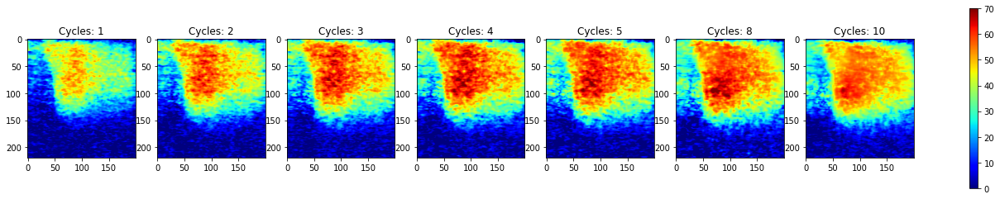

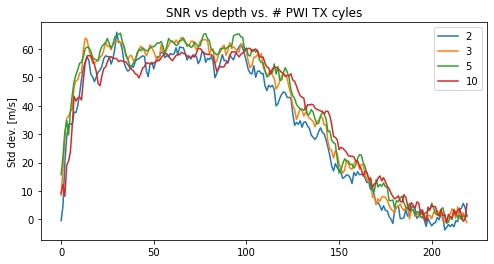

In [76]:
### SNR map ###
cycles = [1,2,3,4,5,8,10]
datatype = 'swdf'
N = len(cycles)

# Load data
dataSW = []
dataEmpty = []

for i in cycles:
    dataset = sp.io.loadmat(path + '/Test_2/b/energy_' + datatype + '_freq4.4' + '_cycles' + str(i) + '_pri100.0_id_0.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in cycles:
    dataset = sp.io.loadmat(path + '/Test_1/b/energy_' + datatype + '_freq4.4' + '_cycles' + str(i) + '_pri100.0_id_0.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * len(cycles)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('Cycles: ' + str(cycles[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
profiles = [1, 2, 4, 6]
for i in profiles:
    ax2.plot(p[i], label=str(cycles[i]))

ax2.legend()
ax2.set_title('SNR vs depth vs. # PWI TX cyles')
ax2.set_ylabel('Std dev. [m/s]')

Text(0, 0.5, 'Normalized energy [dB]')

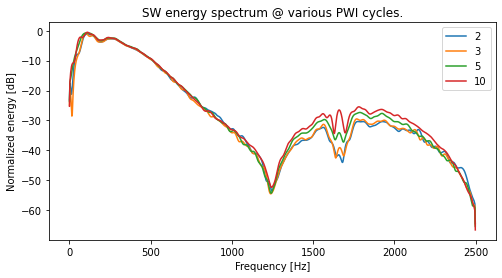

In [77]:
### Spectral analysis ###
cycles = [1,2,3,4,5,8,10]
datatype = 'swd'
N = len(cycles)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + 'Test_2/b/swd_freq4.4' + '_cycles' + str(cycles[i]) + '_pri100.0_id_0.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
profiles = [1, 2, 4, 6]
for i in profiles:
    ax.plot(x_f, spec[i], label=str(cycles[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various PWI cycles.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std dev. [m/s]')

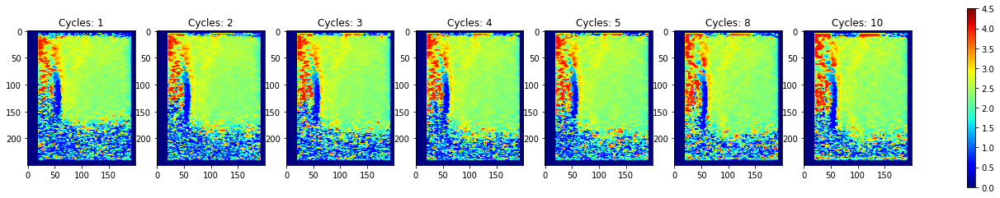

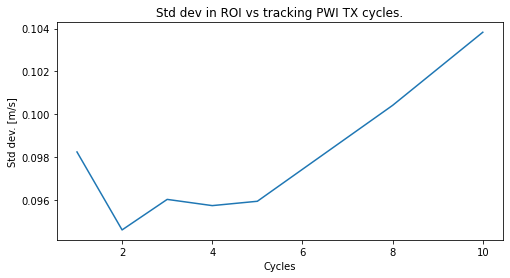

In [81]:
### SWS map variance analysis ###
cycles = [1,2,3,4,5,8,10]
N = len(cycles)

# Load data
dataSWS = []

for i in range(N):
    dataset = sp.io.loadmat(path + 'Test_2/b/sws_freq4.4' + '_cycles' + str(cycles[i]) + '_pri100.0_id_0.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
                             
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * len(freq)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Cycles: ' + str(cycles[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(cycles, var)
ax.set_title('Std dev in ROI vs tracking PWI TX cycles.')
ax.set_xlabel('Cycles')
ax.set_ylabel('Std dev. [m/s]')

## Test 2c

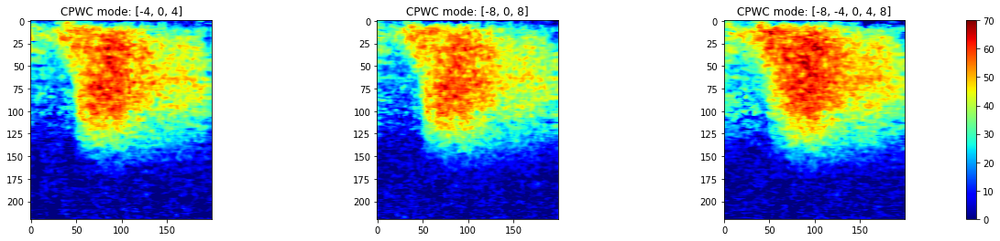

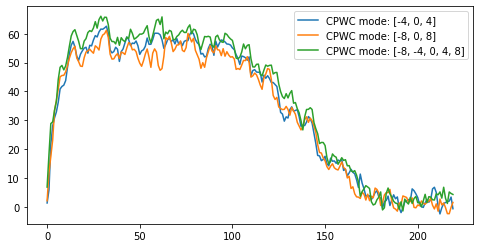

In [84]:
### SNR map ###
idx = [1, 2, 3]
datatype = 'swdf'
mode = ['[0]', '[-4, 0, 4]', '[-8, 0, 8]', '[-8, -4, 0, 4, 8]']
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/c/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/c/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * len(cycles)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('CPWC mode: ' + str(mode[idx[i]]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label='CPWC mode: ' + str(mode[idx[i]]))

ax2.legend()

Text(0, 0.5, 'Normalized energy [dB]')

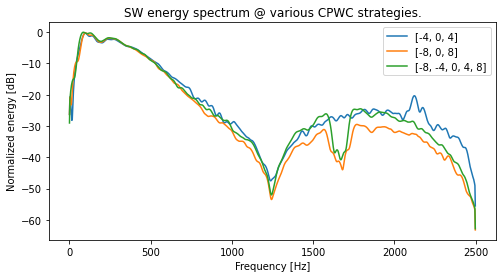

In [86]:
### Spectral analysis ###
idx = [1, 2, 3]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
mode = ['[0]', '[-4, 0, 4]', '[-8, 0, 8]', '[-8, -4, 0, 4, 8]']
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + '/Test_2/c/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(mode[idx[i]]))

ax.legend()
ax.set_title('SW energy spectrum @ various CPWC strategies.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

2.359378449224852
[2.4650128, 2.4720597, 2.5011039]


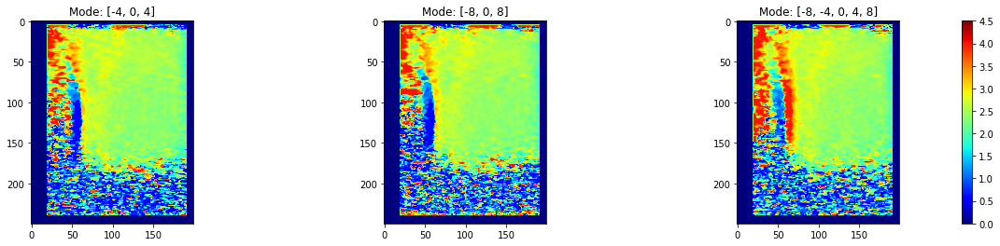

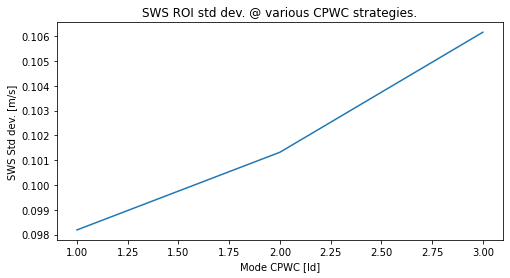

In [88]:
### SWS map variance analysis ###
idx = [1, 2, 3]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/c/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Mode: ' + str(mode[idx[i]]))
    
fig.colorbar(pcm, ax=ax)

# Find mean values variance and plot
var = [0] * N
swsAvg = [0] * N
for i in range(N):
    var[i]    = np.std(dataSWS[i][50:100, 100:150])
    swsAvg[i] = np.mean(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(idx, var)
ax.set_title('SWS ROI std dev. @ various CPWC strategies.')
ax.set_xlabel('Mode CPWC [Id]')
ax.set_ylabel('SWS Std dev. [m/s]')
print(np.sqrt(16.7/3))
print(swsAvg)

## Test 2d

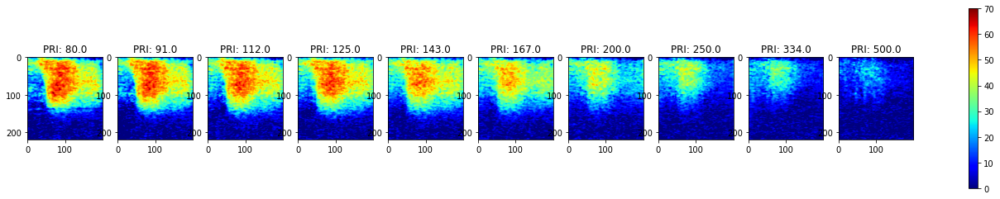

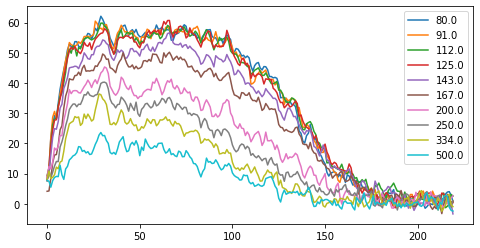

In [5]:
### SNR map ###
pri = [80.0, 91.0, 112.0, 125.0, 143.0, 167.0, 200.0, 250.0, 334.0, 500.0]
N = len(pri)
datatype = 'swdf'

# Load data
dataSW = []
dataEmpty = []

for i in range(N):
    dataset = sp.io.loadmat(path + 'Test_2/d/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri' + str(pri[i]) + '_id_0.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in range(N):
    dataset = sp.io.loadmat(path + 'Test_1/d/energy_' + datatype + '_freq4.4'+ '_cycles2' +'_pri' + str(pri[i]) + '_id_0.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 85:115], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('PRI: ' + str(pri[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(pri[i]))

ax2.legend()
ax2.set_title('SNR vs. depth @ PRI.')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')

Text(0.5, 1.0, 'Fmean vs. pri')

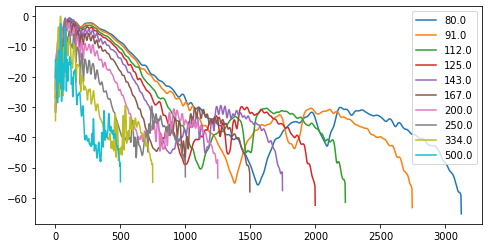

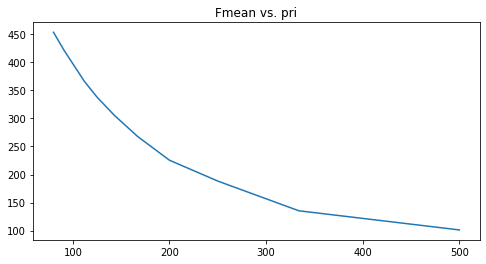

In [13]:
### Spectral analysis ###
pri = [80.0, 91.0, 112.0, 125.0, 143.0, 167.0, 200.0, 250.0, 334.0, 500.0]
N = len(pri)
datatype = 'swd'

NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
Fmean = np.zeros(len(pri))

for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + '/Test_2/d/swd_freq4.4'+ '_cycles2' +'_pri' + str(pri[i]) + '_id_0.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=0.5e6/pri[i], NFFT=2048)
    Fmean[i] = getFmean(spectrum, 0.5e6/pri[i])
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f  = np.arange(0, NFFT//2, 1)
x_fr = np.zeros((len(pri), len(x_f)))
for i in range(len(pri)):
    Fs = 0.5e6/pri[i]
    x_fr[i,...]  = Fs*x_f/NFFT
    
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax.plot(x_fr[i,:], spec[i], label=str(pri[i]))
    

ax.legend()
ax.set_title('SW energy spectrum @ various PWI PRI.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

# Fmean vs pri
fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
ax2.plot(pri, Fmean)
ax2.set_title('Fmean vs. pri')
ax.set_xlabel('PRI [us]')
ax.set_ylabel('SW Mean frequency [Hz]')


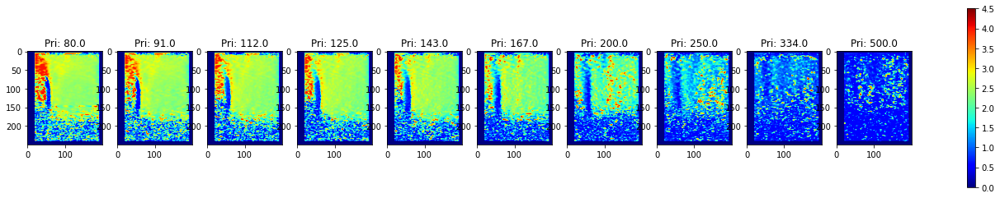

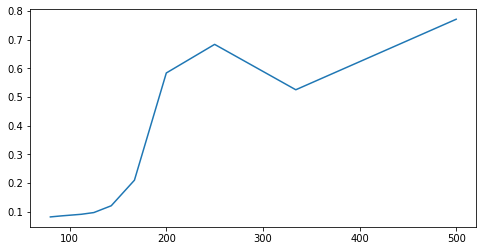

In [55]:
### SWS map variance analysis ###
pri = [80.0, 91.0, 112.0, 125.0, 143.0, 167.0, 200.0, 250.0, 334.0, 500.0]
N = len(pri)

# Load data
dataSWS = []

for i in pri:
    dataset = sp.io.loadmat(path + '/Test_2/d/sws_freq4.4' + '_cycles2' +'_pri' + str(i) + '_id_0.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Pri: ' + str(pri[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(pri, var)

## Test 2e

Text(0, 0.5, 'SNR [dB]')

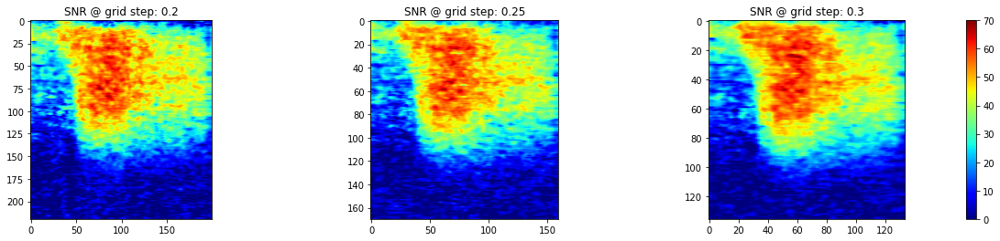

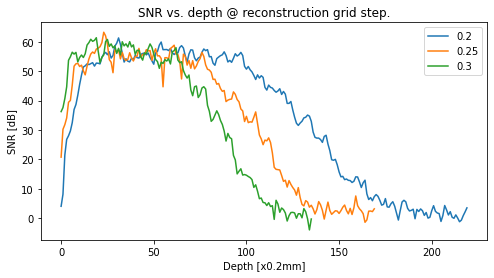

In [6]:
### SNR map ###
idx = [0, 1, 2]
datatype = 'swdf'
grid_step = [0.2, 0.25, 0.3]
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/e/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/e/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i+2)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
l_idx = [100, 80, 66]
r = [10, 8, 6]
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, l_idx[i]-r[i]:l_idx[i]+r[i]], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('SNR @ grid step: ' + str(grid_step[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(grid_step[i]))

ax2.legend()
ax2.set_title('SNR vs. depth @ reconstruction grid step.')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')


In [64]:
p = 100 * (0.2/0.3)
print(p)

66.66666666666667


Text(0, 0.5, 'Normalized energy [dB]')

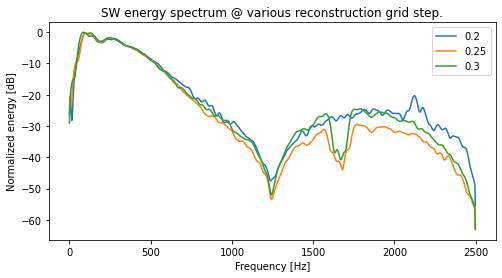

In [10]:
### Spectral analysis ###
idx = [0, 1, 2]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + '/Test_2/c/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(grid_step[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various reconstruction grid step.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std. dev. [m/s]')

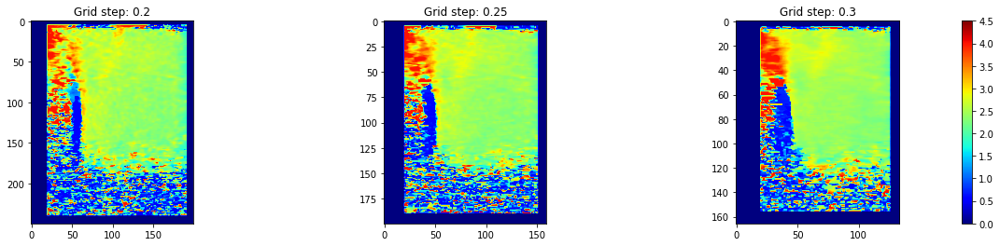

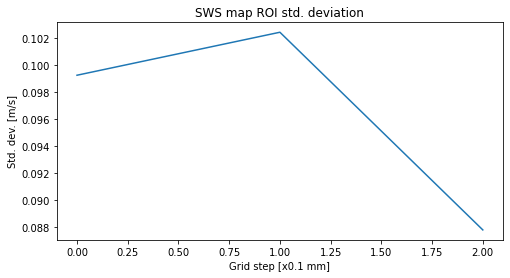

In [13]:
### SWS map variance analysis ###
idx = [0, 1, 2]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/e/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Grid step: ' + str(grid_step[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N

var[0] = np.std(dataSWS[0][50:100, 100:150])
var[1] = np.std(dataSWS[1][40:80, 80:120])
var[2] = np.std(dataSWS[2][33:66, 66:99])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(idx, var)
ax.set_title('SWS map ROI std. deviation')
ax.set_xlabel('Grid step [x0.1 mm]')
ax.set_ylabel('Std. dev. [m/s]')


## Test 2f

Text(0, 0.5, 'SNR [dB]')

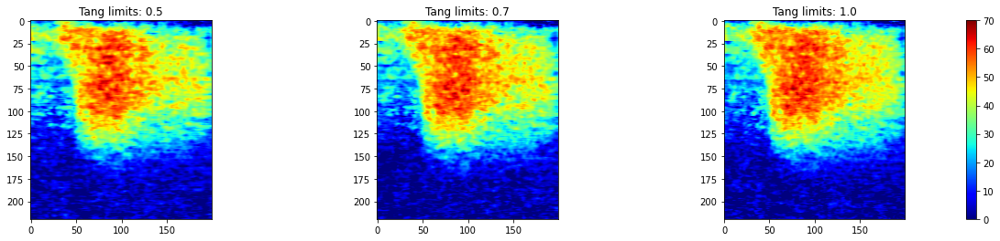

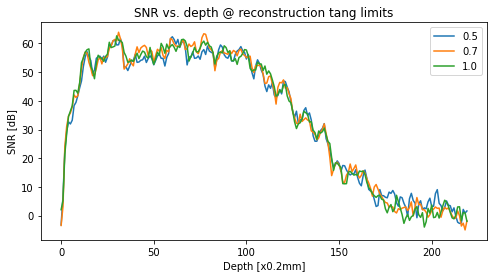

In [16]:
### SNR map ###
idx = [0, 1, 2]
datatype = 'swdf'
tang_limits = [0.5, 0.7, 1.0]
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/f/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/f/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('Tang limits: ' + str(tang_limits[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(tang_limits[i]))

ax2.legend()
ax2.set_title('SNR vs. depth @ reconstruction tang limits')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')

Text(0, 0.5, 'Normalized energy [dB]')

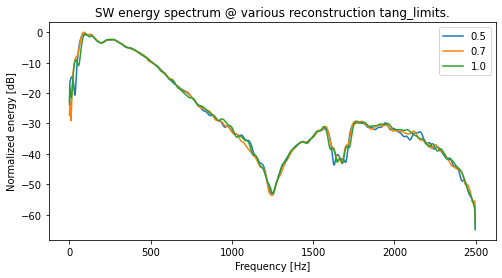

In [17]:
### Spectral analysis ###
idx = [0, 1, 2]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + '/Test_2/f/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(tang_limits[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various reconstruction tang_limits.')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std. dev. [m/s]')

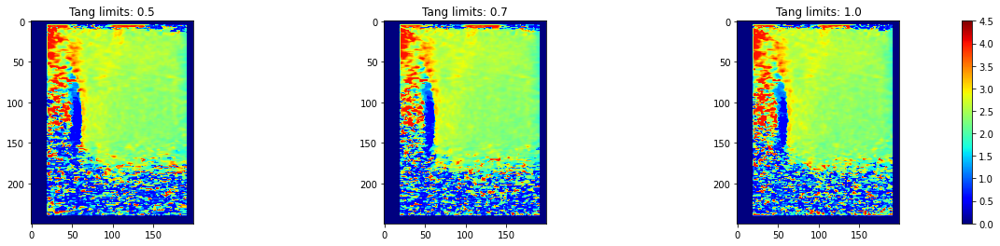

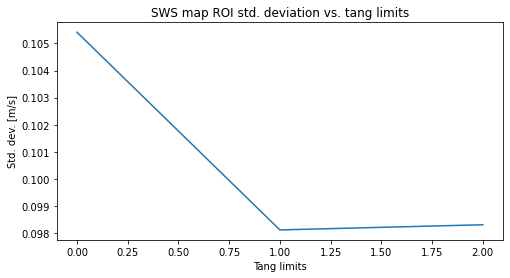

In [18]:
### SWS map variance analysis ###
idx = [0, 1, 2]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/f/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Tang limits: ' + str(tang_limits[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(idx, var)
ax.set_title('SWS map ROI std. deviation vs. tang limits')
ax.set_xlabel('Tang limits')
ax.set_ylabel('Std. dev. [m/s]')

## Test 2g

Text(0, 0.5, 'SNR [dB]')

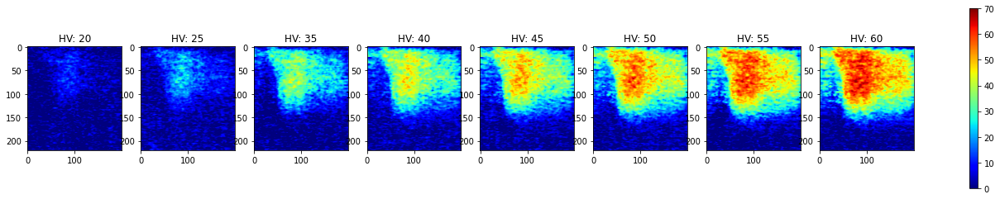

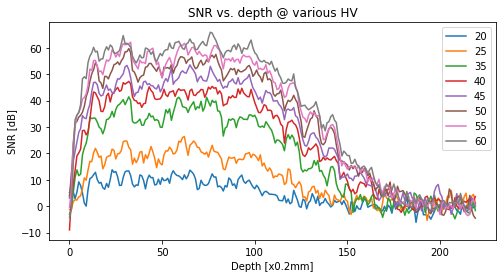

In [22]:
### SNR map ###
idx = [0, 1, 3, 4, 5, 6, 7, 8]
hv = [20, 25, 30, 35, 40, 45, 50, 55, 60]
datatype = 'swdf'
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/g/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/g/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('HV: ' + str(hv[idx[i]]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(hv[idx[i]]))

ax2.legend()
ax2.legend()
ax2.set_title('SNR vs. depth @ various HV')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')

Text(0, 0.5, 'Normalized energy [dB]')

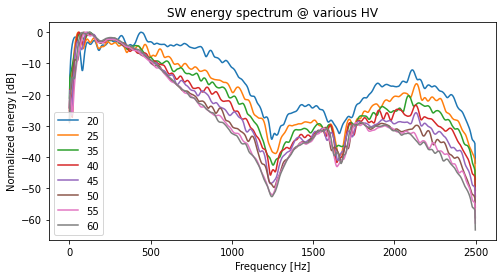

In [25]:
### Spectral analysis ###
idx = [0, 1, 3, 4, 5, 6, 7, 8]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
M = np.zeros(len(idx))
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + 'Test_2/g/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M[i] = np.max(spectrum)  
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/M[i])

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(hv[idx[i]]))

ax.legend()
ax.set_title('SW energy spectrum @ various HV')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std. dev. [m/s]')

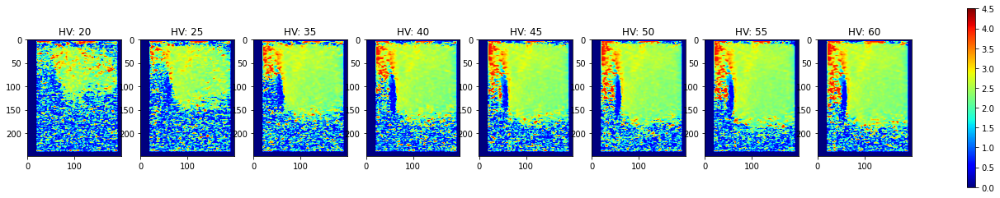

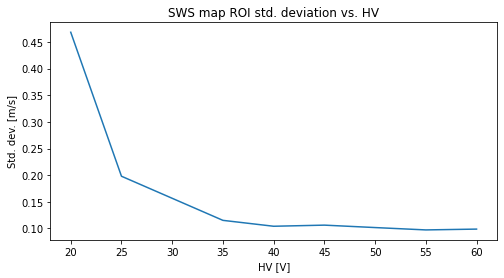

In [31]:
### SWS map variance analysis ###
idx = [0, 1, 3, 4, 5, 6, 7, 8]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/g/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('HV: ' + str(hv[idx[i]]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
hv_x = []
for i in range(len(idx)):
    hv_x.append(hv[idx[i]])
    
ax.plot(hv_x, var)
ax.set_title('SWS map ROI std. deviation vs. HV')
ax.set_xlabel('HV [V]')
ax.set_ylabel('Std. dev. [m/s]')

## Test 2h

Text(0, 0.5, 'SNR [dB]')

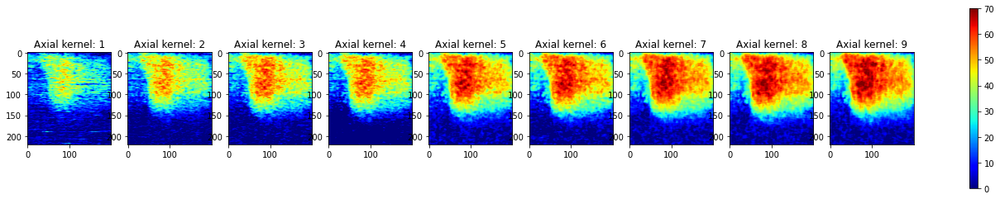

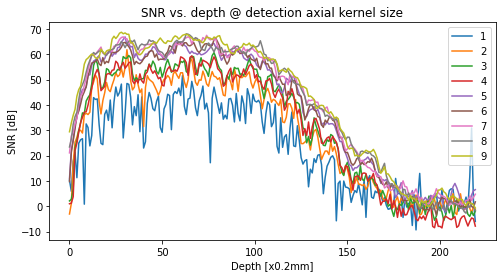

In [32]:
### SNR map ###
idx = [0, 1, 3, 4, 5, 6, 7, 8, 9]
datatype = 'swdf'
axial_kernel = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/h/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/h/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('Axial kernel: ' + str(axial_kernel[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(axial_kernel[i]))

ax2.legend()
ax2.set_title('SNR vs. depth @ detection axial kernel size')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')

Text(0, 0.5, 'Normalized energy [dB]')

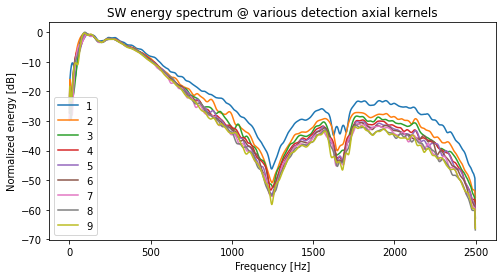

In [33]:
### Spectral analysis ###
idx = [0, 1, 3, 4, 5, 6, 7, 8, 9]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + 'Test_2/h/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(axial_kernel[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various detection axial kernels')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std. dev. [m/s]')

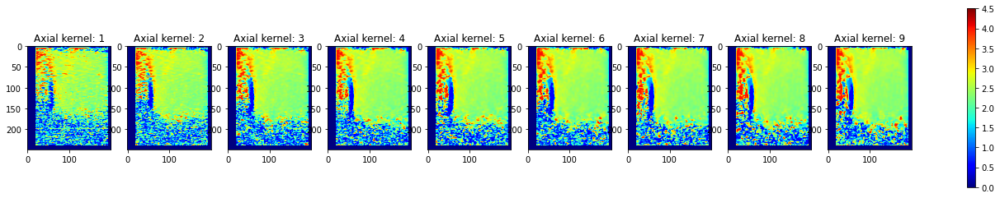

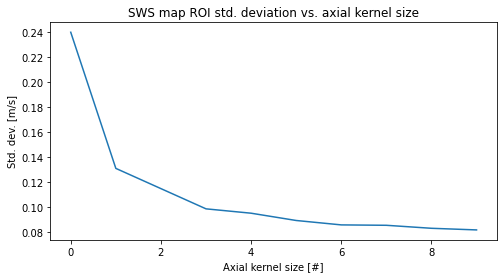

In [34]:
### SWS map variance analysis ###
idx = [0, 1, 3, 4, 5, 6, 7, 8, 9]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/h/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Axial kernel: ' + str(axial_kernel[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(idx, var)
ax.set_title('SWS map ROI std. deviation vs. axial kernel size')
ax.set_xlabel('Axial kernel size [#]')
ax.set_ylabel('Std. dev. [m/s]')

## Test 2i

Text(0, 0.5, 'SNR [dB]')

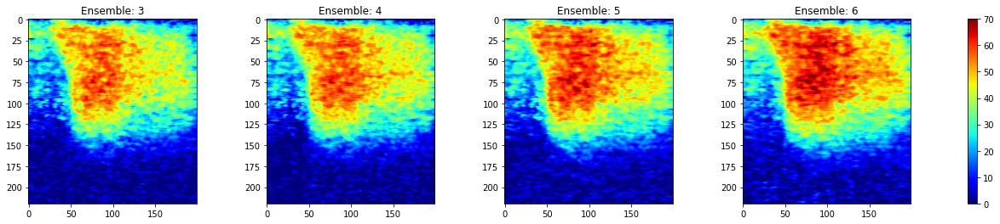

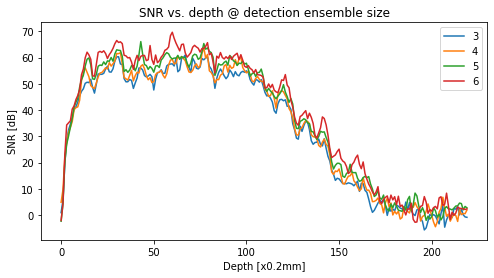

In [35]:
### SNR map ###
idx = [0, 1, 2, 3]
datatype = 'swdf'
ensemble_size = [3, 4, 5, 6]
N = len(idx)

# Load data
dataSW = []
dataEmpty = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/i/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataSW.append(din)    
    
for i in idx:
    dataset = sp.io.loadmat(path + '/Test_1/i/energy_' + datatype + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    din = dataset["data"]                        
    dataEmpty.append(din)     
      
# Process data
SNR = []
p = []
for i in range(N):
    # Calc SNR map and axial profile
    SNRi = dataSW[i] / dataEmpty[i]
    SNRi = 20 * np.log10(SNRi)
    SNR.append(SNRi)
    profile = np.squeeze(np.mean(SNRi[:, 95:105], 1))
    p.append(profile)
                            
# Print
norm = plt.Normalize(0, 70, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(SNR[i], cmap='jet', norm=norm)
    ax[i].set_title('Ensemble: ' + str(ensemble_size[i]))
    
fig.colorbar(pcm, ax=ax)

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(N):
    ax2.plot(p[i], label=str(ensemble_size[i]))

ax2.legend()
ax2.set_title('SNR vs. depth @ detection ensemble size')
ax2.set_xlabel('Depth [x0.2mm]')
ax2.set_ylabel('SNR [dB]')

Text(0, 0.5, 'Normalized energy [dB]')

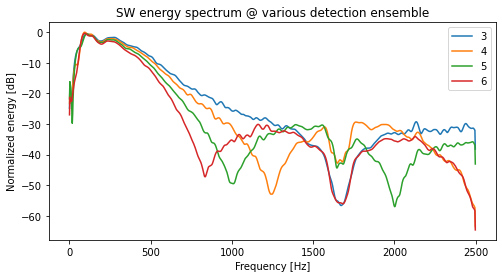

In [37]:
### Spectral analysis ###
idx = [0, 1, 2, 3]
datatype = 'swd'
N = len(idx)
NFFT = 2048
Fs = 1/200e-6
    
# Load and process data
MV = -200
spec = []
for i in range(N):
    # Get data
    dataset = sp.io.loadmat(path + 'Test_2/i/swd_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i)+'.mat')
    swd = dataset["data"]

    # Calc spectrum in a ROI
    spectrum = SW_spectralAnalysis_Temporal(swd[80:100, 100:120, :], Fs=Fs, NFFT=2048)
    M = np.max(spectrum)
    if(M > MV):
        MV = M    
    
    spec.append(spectrum)

                            
### Print ###
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(N):
    spec[i] = 20 * np.log10(spec[i]/MV)

fig, ax = plt.subplots(1, 1, figsize=(8, 4))

for i in range(N):
    ax.plot(x_f, spec[i], label=str(ensemble_size[i]))

ax.legend()
ax.set_title('SW energy spectrum @ various detection ensemble')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

Text(0, 0.5, 'Std. dev. [m/s]')

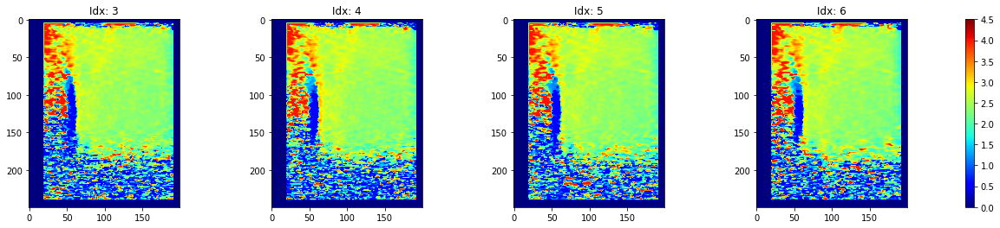

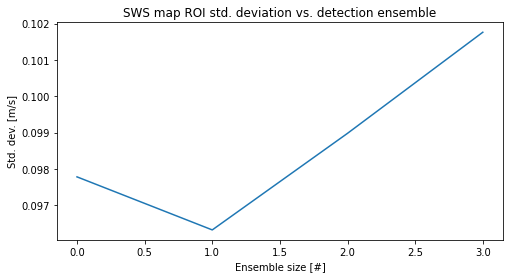

In [39]:
### SWS map variance analysis ###
idx = [0, 1, 2, 3]
N = len(idx)

# Load data
dataSWS = []

for i in idx:
    dataset = sp.io.loadmat(path + '/Test_2/i/sws_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(i) +'.mat')
    din = (dataset["data"])
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
         
                           
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title('Idx: ' + str(ensemble_size[i]))
    
fig.colorbar(pcm, ax=ax)

# Find variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 100:150])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(idx, var)
ax.set_title('SWS map ROI std. deviation vs. detection ensemble')
ax.set_xlabel('Ensemble size [#]')
ax.set_ylabel('Std. dev. [m/s]')

# Test 3

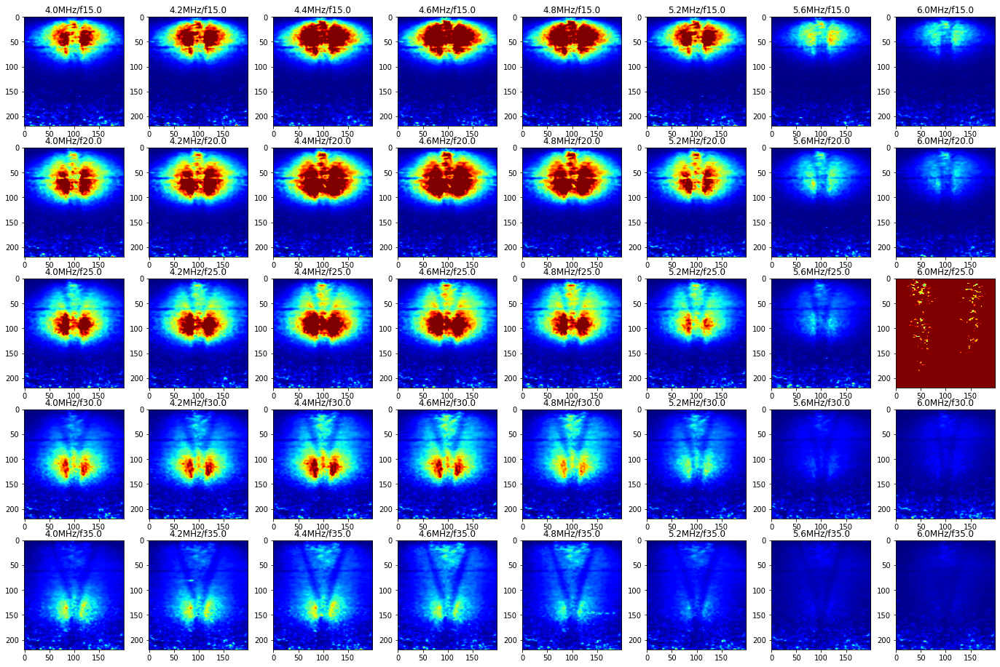

In [41]:
# Push energy distribution
#freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.0, 5.2, 5.6, 5.8, 6.0]
freq = [4.0, 4.2, 4.4, 4.6, 4.8, 5.2, 5.6, 6.0]
foci = [15.0, 20.0, 25.0, 30.0, 35.0]
pbAp = [29, 39, 48, 58, 68]
datatype = 'swdf'

# Correct frequencies
freal = [0] * len(freq)
for i in range(len(freq)):
    (f1, f2) = getTxFreq(freq[i])
    freal[i] = f1

# Load data and dprint
rows, cols = (len(foci), len(freq))
data = [[0]*cols]*rows

norm = plt.Normalize(0, 2.5e-5, True)
fig, ax = plt.subplots(len(foci), len(freq), figsize=(24, 16))

# Load noise energy
noiseE_d = sp.io.loadmat(path + '/Test_1/a/energy_swdf_freq4.4_cycles2_pri100.0_id_0.mat')
noiseE = noiseE_d["data"] 
E_total = np.zeros((len(foci), len(freq)))

for i in range(len(foci)):
    for j in range(len(freq)):
        # Load
        pbfreq = str(freq[j])
        foc = str(foci[i])
        pblen = '250.0'
        pbap = str(pbAp[i])
        idx = '0'
        dataset = sp.io.loadmat(path+'/Test_3/swdf_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pblen+'_pbAp'+pbap+'_id_'+idx+'.mat')
        din = dataset["data"]  
        
        # Get energy map
        ddataE1 = cp.asarray(np.squeeze(din[0, 10:-20, ...]))
        ddataE2 = cp.asarray(np.squeeze(din[1, 10:-20, ...]))
        m = cp.mean(ddataE1, axis=2)
        ddataE1 = cp.transpose(ddataE1, [2,0,1])
        ddataE1 = cp.subtract(ddataE1, m)
        ddataE1 = cp.transpose(ddataE1, [1,2,0])
        E1 = cp.power(ddataE1, 2)
        E1 = cp.squeeze(np.sum(E1, 2))
     
        m = cp.mean(ddataE2, axis=2)
        ddataE2 = cp.transpose(ddataE2, [2,0,1])
        ddataE2 = cp.subtract(ddataE2, m)
        ddataE2 = cp.transpose(ddataE2, [1,2,0])
        E2 = cp.power(ddataE2, 2)
        E2 = cp.squeeze(np.sum(E2, 2))  
        E = E1 + E2
        E_cpu = E.get()
        E_cpu = E_cpu - noiseE
        E_total[i,j] = np.sum(E_cpu)
                 
        pcm=ax[i][j].imshow(E_cpu, cmap='jet', norm=norm)
        ax[i][j].set_title(str(freq[j])+'MHz/f'+str(foci[i]))
        #fig.colorbar(pcm, ax=ax)
        


Text(0.5, 1.0, 'Energy efficiency factor vs. frequency @ various depths')

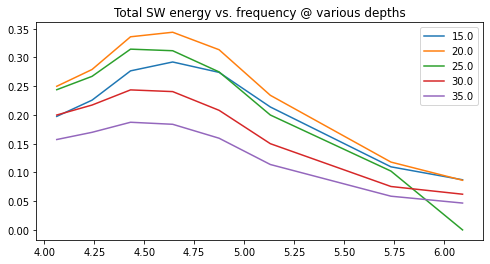

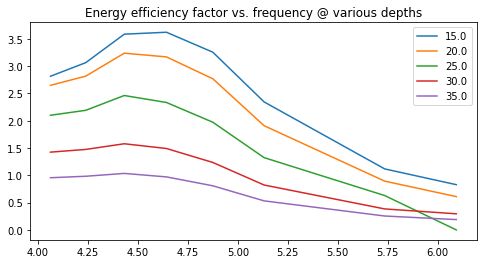

In [42]:
# Plot SW Total energy vs. frequency for each focus point
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
E_total[2, 7] = 0
for i in range(len(foci)):
    ax.plot(freal, E_total[i, :], label=str(foci[i]))
    
ax.legend() 
ax.set_title('Total SW energy vs. frequency @ various depths')


# Plot Total SW energy / Total Electrical energy vs. frequency for single focus point
Ee = np.zeros((len(foci), len(freq)))
for i in range(len(foci)):
    for j in range(len(freq)):
        Ee[i, j] = getPushTxEnergy(HV=55, Length=250, f=freq[j], Nch=pbAp[i], Cap=200e-12)

Eff = E_total/Ee

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(foci)):
    ax2.plot(freal, np.squeeze(Eff[i, :]), label=str(foci[i]))
    
ax2.legend() 
ax2.set_title('Energy efficiency factor vs. frequency @ various depths')



In [43]:
### Spectral analysis ###
N = len(idx)
NFFT = 2048
Fs = 1/200e-6

M = np.zeros((len(foci), len(freq)))
spec = np.zeros((len(foci), len(freq), NFFT//2))
depths = [40, 60, 90, 120, 140]
for i in range(len(foci)):
    for j in range(len(freq)):
        # Load
        pbfreq = str(freq[j])
        foc = str(foci[i])
        pblen = '250.0'
        pbap = str(pbAp[i])
        idx = '0'
        dataset = sp.io.loadmat(path+'/Test_3/swd_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pblen+'_pbAp'+pbap+'_id_'+idx+'.mat')
        din = dataset["data"]  
        # Calc spectrum in a ROI
        d = depths[i]
        spectrum = SW_spectralAnalysis_Temporal(din[d-20:d+20, 100:120, :], Fs=Fs, NFFT=2048)
        spec[i, j, :] = spectrum
        M[i,j] = np.max(spectrum)     
                          
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(len(foci)):
    for j in range(len(freq)):
        spec[i, j, :] = 20 * np.log10(spec[i, j, :]/M[i,j])

Text(0, 0.5, 'Normalized energy [dB]')

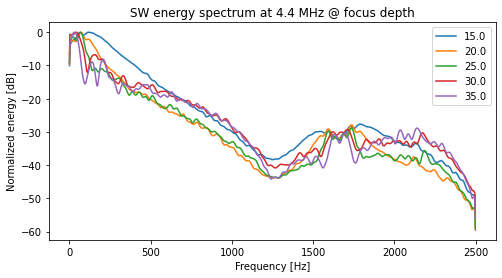

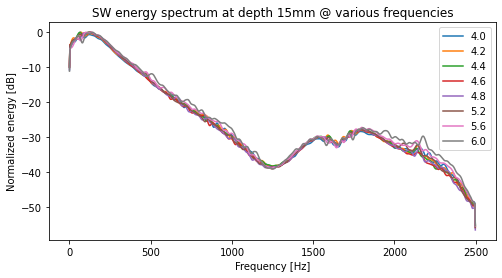

In [44]:
### Print ###
# Print for single frequency (sweep through foci)
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(foci)):
    ax.plot(x_f, spec[i, 2], label=str(foci[i]))
    
ax.legend()
ax.set_title('SW energy spectrum at 4.4 MHz @ focus depth')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')

# Print for single foci (sweep through freq)
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(freq)):
    ax.plot(x_f, spec[0, i], label=str(freq[i]))

ax.legend()
ax.set_title('SW energy spectrum at depth 15mm @ various frequencies')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Normalized energy [dB]')    


# Test 4

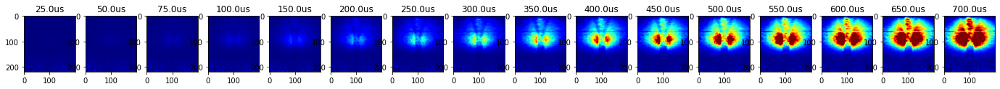

In [45]:
# Push energy distribution
pblen = [25.0, 50.0, 75.0, 100.0, 150.0, 200.0, 250.0, 300.0, 350.0, 400.0, 450.0, 500.0, 550.0, 600.0, 650.0, 700.0]
datatype = 'swdf'

# Load data and print
norm = plt.Normalize(0, 10e-5, True)
fig, ax = plt.subplots(1, len(pblen), figsize=(24, 16))

# Load noise energy
noiseE_d = sp.io.loadmat(path + '/Test_1/a/energy_swdf_freq4.4_cycles2_pri100.0_id_0.mat')
noiseE = noiseE_d["data"] 
E_total = np.zeros(len(pblen))

for i in range(len(pblen)):
    # Load
    pbfreq = str(4.4)
    foc = str(25.0)
    pbleni = str(pblen[i])
    pbap = str(48)
    idx = '0'
    dataset = sp.io.loadmat(path+'/Test_4/swdf_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pbleni+'_pbAp'+pbap+'_id_'+idx+'.mat')
    din = dataset["data"]  

    # Get energy map
    ddataE1 = cp.asarray(np.squeeze(din[0, 10:-20, ...]))
    ddataE2 = cp.asarray(np.squeeze(din[1, 10:-20, ...]))
    m = cp.mean(ddataE1, axis=2)
    ddataE1 = cp.transpose(ddataE1, [2,0,1])
    ddataE1 = cp.subtract(ddataE1, m)
    ddataE1 = cp.transpose(ddataE1, [1,2,0])
    E1 = cp.power(ddataE1, 2)
    E1 = cp.squeeze(np.sum(E1, 2))

    m = cp.mean(ddataE2, axis=2)
    ddataE2 = cp.transpose(ddataE2, [2,0,1])
    ddataE2 = cp.subtract(ddataE2, m)
    ddataE2 = cp.transpose(ddataE2, [1,2,0])
    E2 = cp.power(ddataE2, 2)
    E2 = cp.squeeze(np.sum(E2, 2))  
    E = E1 + E2
    E_cpu = E.get()
    E_cpu = E_cpu - noiseE
    E_total[i] = np.sum(E_cpu)

    pcm=ax[i].imshow(E_cpu, cmap='jet', norm=norm)
    ax[i].set_title(str(pblen[i])+'us')
    #fig.colorbar(pcm, ax=ax)
        

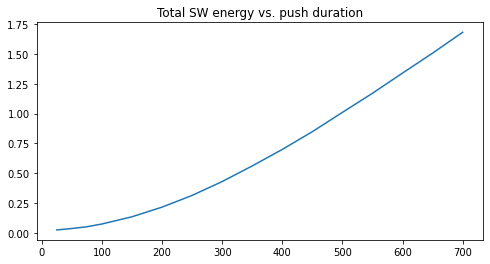

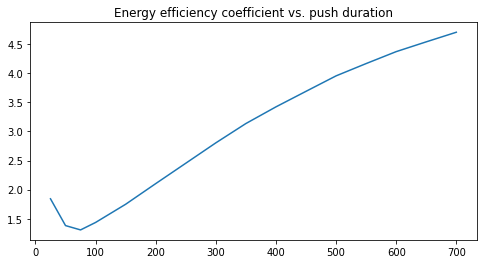

In [46]:
# Plot total SW energy vs. pblen
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(pblen, E_total)
ax.set_title('Total SW energy vs. push duration')

#Plot Total SW energy / Total Electrical energy vs. frequency for single focus point
Ee = np.zeros(len(pblen))
for i in range(len(pblen)):
    Ee[i] = getPushTxEnergy(HV=55, Length=pblen[i], f=4.4, Nch=48, Cap=200e-12)

Eff = E_total/Ee

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
ax2.set_title('Energy efficiency coefficient vs. push duration')
ax2.plot(pblen, Eff)

In [47]:
### Spectral analysis ###
pblen = [25.0, 50.0, 75.0, 100.0, 150.0, 200.0, 250.0, 300.0, 350.0, 400.0, 450.0, 500.0, 550.0, 600.0, 650.0, 700.0]
NFFT = 2048
Fs = 1/200e-6
M = [0]*len(pblen)
Fmean = np.zeros(len(pblen))

spec = np.zeros((len(pblen), NFFT//2))
for i in range(len(pblen)):
    # Load
    pbfreq = str(4.4)
    foc = str(25.0)
    pbleni = str(pblen[i])
    pbap = str(48)
    idx = '0'
    dataset = sp.io.loadmat(path+'/Test_4/swd_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pbleni+'_pbAp'+pbap+'_id_'+idx+'.mat')
    din = dataset["data"]  
    
    # Calc spectrum in a ROI
    d = 90
    spectrum = SW_spectralAnalysis_Temporal(din[d-20:d+20, 100:120, :], Fs=Fs, NFFT=2048)
    Fmean[i] = getFmean(spectrum, Fs)
    spec[i, :] = spectrum
    M[i] = np.max(spectrum)       
                          
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(len(pblen)):
    spec[i, :] = 20 * np.log10(spec[i, :]/M[i])

Text(0.5, 1.0, 'Fmean vs.Push length')

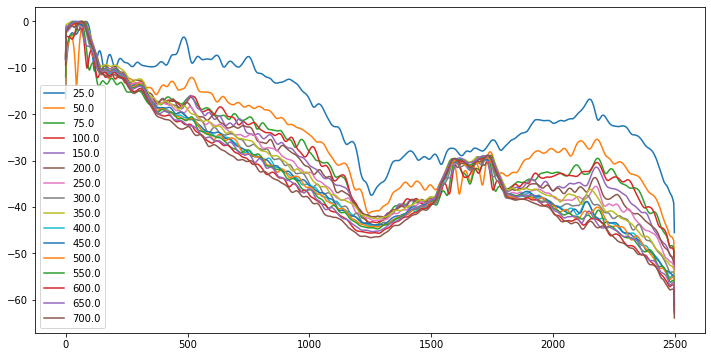

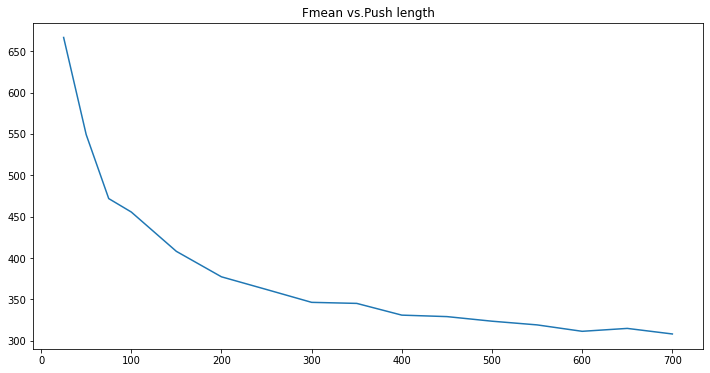

In [48]:
### Print ###
# Print for single frequency (sweep through foci)
fig, ax = plt.subplots(1, 1, figsize=(12, 6))
for i in range(len(pblen)):
    ax.plot(x_f, spec[i], label=str(pblen[i]))
    
ax.legend()

# Print Fmean vs. Pblength
fig2, ax2 = plt.subplots(1, 1, figsize=(12, 6))
ax2.plot(pblen, Fmean)
ax2.set_title('Fmean vs.Push length')


Text(0, 0.5, 'Std dev. [m/s]')

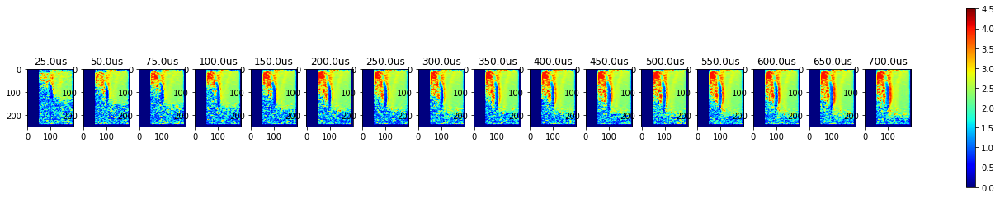

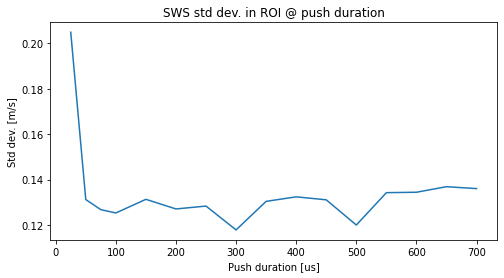

In [50]:
### SWS map variance analysis ###
N = len(pblen)

# Load data
dataSWS = []

for i in range(N):
    # Load
    pbfreq = str(4.4)
    foc = str(25.0)
    pbleni = str(pblen[i])
    pbap = str(48)
    idx = '0'    
    dataset = sp.io.loadmat(path+'/Test_4/sws_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pbleni+'_pbAp'+pbap+'_id_'+idx+'.mat')
    din = dataset["data"] 
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
                               
# Print
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title(str(pblen[i])+'us')
    
fig.colorbar(pcm, ax=ax)

# Find avg, variance and plot
var = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 120:160])
    
    
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(pblen, var)
ax.set_title('SWS std dev. in ROI @ push duration')
ax.set_xlabel('Push duration [us]')
ax.set_ylabel('Std dev. [m/s]')   

# Test 5

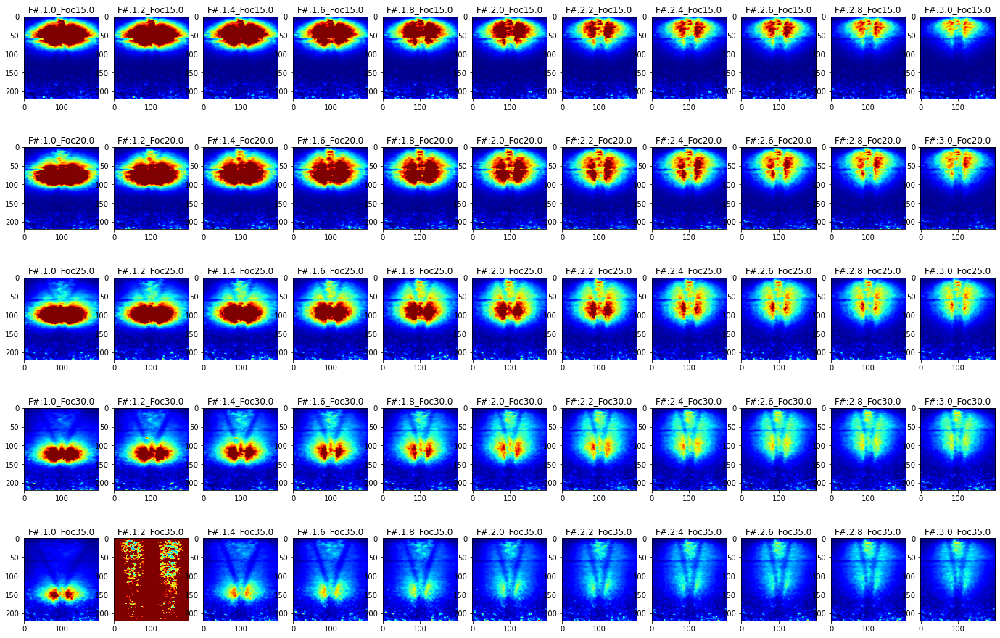

In [17]:
# Push energy distribution
fnumber = [1.0, 1.2, 1.4, 1.6, 1.8, 2.0, 2.2, 2.4, 2.6, 2.8, 3.0]
foci = [15.0, 20.0, 25.0, 30.0, 35.0]
pbAp = [[42, 42, 36, 32, 28, 26, 23, 21, 20, 18, 17],
        [68, 56, 48, 42, 38, 34, 31, 28, 26, 24, 23],
        [84, 70, 60, 53, 47, 42, 39, 35, 33, 30, 28],
        [101, 84, 72, 63, 56, 51, 46, 42, 39, 36, 34],
        [118, 90, 84, 74, 66, 59, 54, 49, 46, 42, 40]]
datatype = 'swdf'

# Load data and dprint
norm = plt.Normalize(0, 2.5e-5, True)
fig, ax = plt.subplots(len(foci), len(fnumber), figsize=(24, 16))

# Load noise energy
noiseE_d = sp.io.loadmat(path + '/Test_1/a/energy_swdf_freq4.4_cycles2_pri100.0_id_0.mat')
noiseE = noiseE_d["data"] 
E_total = np.zeros((len(foci), len(fnumber)))

for i in range(len(foci)):
    for j in range(len(fnumber)):
        # Load
        pbfreq = str(4.4)
        foc = str(foci[i])
        pblen = '250.0'
        pbap = str(pbAp[i][j])
        idx = '0'
        dataset = sp.io.loadmat(path+'/Test_5/swdf_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pblen+'_pbAp'+pbap+'_id_'+idx+'.mat')
        din = dataset["data"]  
        
        # Get energy map
        ddataE1 = cp.asarray(np.squeeze(din[0, 10:-20, ...]))
        ddataE2 = cp.asarray(np.squeeze(din[1, 10:-20, ...]))
        m = cp.mean(ddataE1, axis=2)
        ddataE1 = cp.transpose(ddataE1, [2,0,1])
        ddataE1 = cp.subtract(ddataE1, m)
        ddataE1 = cp.transpose(ddataE1, [1,2,0])
        E1 = cp.power(ddataE1, 2)
        E1 = cp.squeeze(np.sum(E1, 2))
     
        m = cp.mean(ddataE2, axis=2)
        ddataE2 = cp.transpose(ddataE2, [2,0,1])
        ddataE2 = cp.subtract(ddataE2, m)
        ddataE2 = cp.transpose(ddataE2, [1,2,0])
        E2 = cp.power(ddataE2, 2)
        E2 = cp.squeeze(np.sum(E2, 2))  
        E = E1 + E2
        E_cpu = E.get()
        E_cpu = E_cpu - noiseE
        E_total[i,j] = np.sum(E_cpu)
                 
        pcm=ax[i][j].imshow(E_cpu, cmap='jet', norm=norm)
        ax[i][j].set_title('F#:'+str(fnumber[j])+'_Foc'+str(foci[i]))
        #fig.colorbar(pcm, ax=ax)
        
    

Text(0.5, 1.0, 'Push electrical excitation Energy vs. F# @ various Foci')

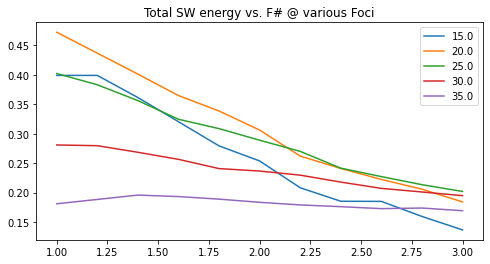

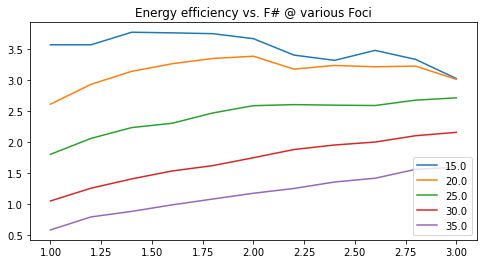

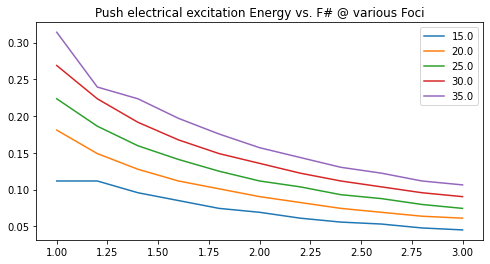

In [19]:
# Plot Total SW energy vs. F# @ various foci
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
E_total[4, 1] = (E_total[4, 0] + E_total[4, 2])/2
for i in range(len(foci)):
    ax.plot(fnumber, E_total[i, :], label=str(foci[i])) 
ax.set_title('Total SW energy vs. F# @ various Foci')
ax.legend() 
    
# Plot Total SW energy / Total Electrical energy vs. frequency for single focus point
Ee = np.zeros((len(foci), len(fnumber)))
for i in range(len(foci)):
    for j in range(len(fnumber)):
        Ee[i, j] = getPushTxEnergy(HV=55, Length=250, f=4.4, Nch=pbAp[i][j], Cap=200e-12)

Eff = E_total/Ee

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(foci)):
    ax2.plot(fnumber, np.squeeze(Eff[i, :]), label=str(foci[i]))
ax2.legend()      
ax2.set_title('Energy efficiency vs. F# @ various Foci') 

fig3, ax3 = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(foci)):
    ax3.plot(fnumber, np.squeeze(Ee[i, :]), label=str(foci[i]))
ax3.legend() 
ax3.set_title('Push electrical excitation Energy vs. F# @ various Foci')
    

In [20]:
### Spectral analysis ###
NFFT = 2048
Fs = 1/200e-6

M = np.zeros((len(foci), len(fnumber)))
Fmean = np.zeros((len(foci), len(fnumber)))
spec = np.zeros((len(foci), len(fnumber), NFFT//2))
depths = [40, 70, 90, 125, 145]
for i in range(len(foci)):
    for j in range(len(fnumber)):
        # Load
        pbfreq = str(4.4)
        foc = str(foci[i])
        pblen = '250.0'
        pbap = str(pbAp[i][j])
        idx = '0'
        dataset = sp.io.loadmat(path+'/Test_5/swd_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pblen+'_pbAp'+pbap+'_id_'+idx+'.mat')
        din = dataset["data"]  
        # Calc spectrum in a ROI
        d = depths[i]
        spectrum = SW_spectralAnalysis_Temporal(din[d-20:d+20, 100:120, :], Fs=Fs, NFFT=2048)
        spec[i, j, :] = spectrum
        Fmean[i,j] = getFmean(spectrum, Fs)
        M[i,j] = np.max(spectrum)      
                          
x_f = np.arange(0, NFFT//2, 1)
x_f = Fs*x_f/NFFT
        
# Normalize and compress        
for i in range(len(foci)):
    for j in range(len(fnumber)):
        spec[i, j, :] = 20 * np.log10(spec[i, j, :]/M[i,j])

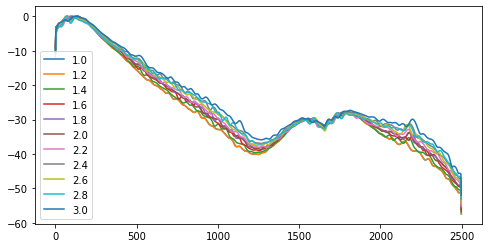

In [22]:
### Print ###
# Print for single foci (sweep through fnumber)
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(fnumber)):
    ax.plot(x_f, spec[0, i], label=str(fnumber[i]))
    
ax.legend()

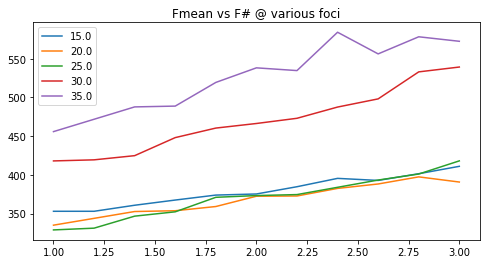

In [25]:
# Print Fmean vs F# @ various foci
Fmean[4, 1] = (Fmean[4, 0] + Fmean[4, 2])/2
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for i in range(len(foci)):
    ax.plot(fnumber, Fmean[i, :], label=str(foci[i]))

ax.set_title('Fmean vs F# @ various foci') 
ax.legend()

# Test 6

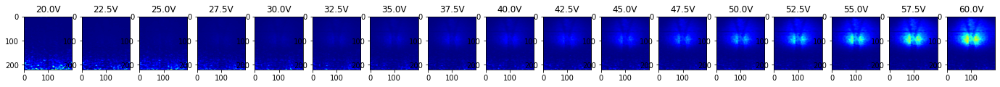

In [15]:
# Push energy distribution
idx = range(0, 17, 1)
hv = np.arange(20, 62.5, 2.5)
datatype = 'swdf'

noiseIdx = [0, 0, 1, 1, 3, 3, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8]

# Load data and print
norm = plt.Normalize(0, 10e-5, True)
fig, ax = plt.subplots(1, len(idx), figsize=(24, 16))


E_total = np.zeros(len(idx))

for i in range(len(idx)):
    # Load
    pbfreq = str(4.4)
    foc = str(25.0)
    pbleni = str(250.0)
    pbap = str(48)
    idx = str(i)
    dataset = sp.io.loadmat(path+'/Test_6/swdf_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pbleni+'_pbAp'+pbap+'_id_'+idx+'.mat')
    din = dataset["data"]  
    
    noiseE_d = sp.io.loadmat(path + '/Test_1/g/energy_swdf_freq4.4_cycles2_pri100.0_id_'+str(noiseIdx[i])+'.mat')
    noiseE = noiseE_d["data"] 

    # Get energy map
    ddataE1 = cp.asarray(np.squeeze(din[0, 10:-20, ...]))
    ddataE2 = cp.asarray(np.squeeze(din[1, 10:-20, ...]))
    m = cp.mean(ddataE1, axis=2)
    ddataE1 = cp.transpose(ddataE1, [2,0,1])
    ddataE1 = cp.subtract(ddataE1, m)
    ddataE1 = cp.transpose(ddataE1, [1,2,0])
    E1 = cp.power(ddataE1, 2)
    E1 = cp.squeeze(np.sum(E1, 2))

    m = cp.mean(ddataE2, axis=2)
    ddataE2 = cp.transpose(ddataE2, [2,0,1])
    ddataE2 = cp.subtract(ddataE2, m)
    ddataE2 = cp.transpose(ddataE2, [1,2,0])
    E2 = cp.power(ddataE2, 2)
    E2 = cp.squeeze(np.sum(E2, 2))  
    E = E1 + E2
    E_cpu = E.get()
    E_cpu = E_cpu - noiseE
    E_total[i] = np.sum(E_cpu)

    pcm=ax[i].imshow(E_cpu, cmap='jet', norm=norm)
    ax[i].set_title(str(hv[i])+'V')
    #fig.colorbar(pcm, ax=ax)
        


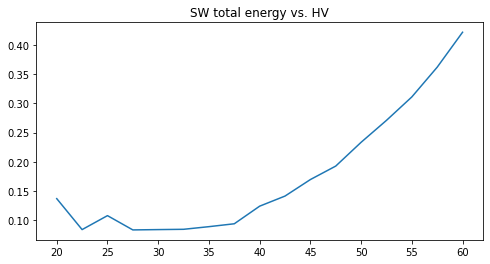

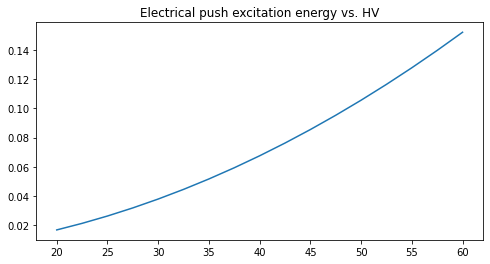

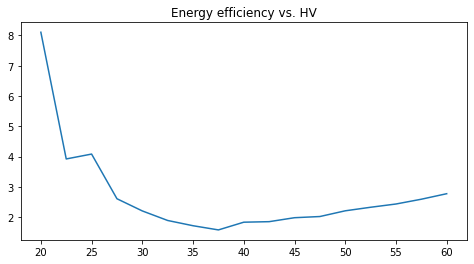

In [16]:
# Plot HV vs. SW energy total
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax.plot(hv, E_total)
ax.set_title('SW total energy vs. HV')

Ee = np.zeros(len(hv))
for i in range(len(hv)):
    Ee[i] = getPushTxEnergy(HV=hv[i], Length=250, f=4.4, Nch=48, Cap=200e-12)

Eff = E_total/Ee

# Plot HV vs. push excitation electrical energy
fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
ax2.plot(hv, Ee)
ax2.set_title('Electrical push excitation energy vs. HV')

#Plot Total SW energy / Total Electrical energy vs. frequency for single focus point
fig3, ax3 = plt.subplots(1, 1, figsize=(8, 4))
ax3.set_title('Energy efficiency vs. HV')
ax3.plot(hv, Eff)

Text(0.5, 1.0, 'HV vs. mean SWS in a ROI')

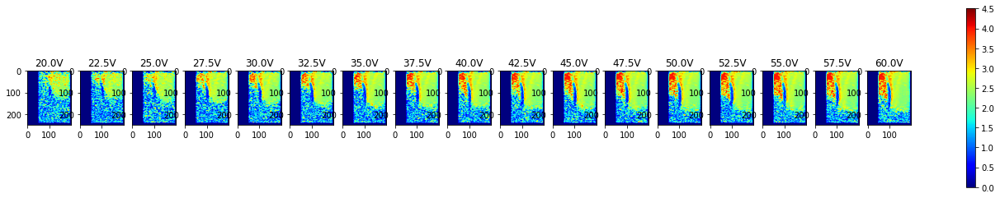

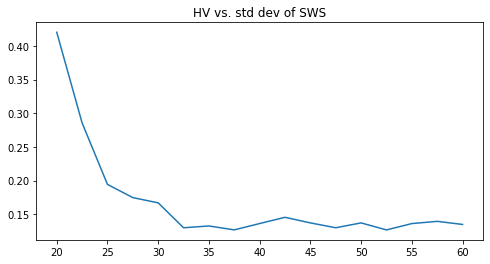

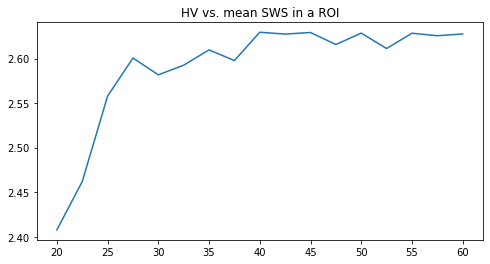

In [17]:
### SWS map variance analysis ###
N = len(hv)
idx = range(0, 17, 1)

# Load data
dataSWS = []

for i in range(N):
    # Load
    pbfreq = str(4.4)
    foc = str(25.0)
    pbleni = str(250.0)
    pbap = str(48)
    idxx = str(idx[i])   
    dataset = sp.io.loadmat(path+'/Test_6/sws_pbfreq'+pbfreq+'_foc'+foc+'_pblen'+pbleni+'_pbAp'+pbap+'_id_'+idxx+'.mat')
    din = dataset["data"] 
    din = np.squeeze(din[0, 0, ...])      
    dataSWS.append(din)    
                               
# Print SWS maps
norm = plt.Normalize(0, 4.5, True)
ax = [] * N
fig, ax = plt.subplots(1, N, figsize=(24, 4))
for i in range(N):
    pcm=ax[i].imshow(dataSWS[i], cmap='jet', norm=norm)
    ax[i].set_title(str(hv[i])+'V')
    
fig.colorbar(pcm, ax=ax)

# Find mean SWS, variance and plot
var = [0] * N
avg_sws = [0] * N
for i in range(N):
    var[i] = np.std(dataSWS[i][50:100, 130:180])
    avg_sws[i] = np.mean(dataSWS[i][50:100, 100:150])
    
    
fig1, ax1 = plt.subplots(1, 1, figsize=(8, 4))
ax1.plot(hv, var)
ax1.set_title('HV vs. std dev of SWS')

fig2, ax2 = plt.subplots(1, 1, figsize=(8, 4))
ax2.plot(hv, avg_sws)
ax2.set_title('HV vs. mean SWS in a ROI')

In [39]:
print(idx)

16


# Test 9

In [18]:
# Push energy distribution
hv       = [30, 45, 60]
pblen    = [25.0, 50.0, 100.0, 250.0, 500.0]
idx      = range(10)
noiseIdx = [1, 5, 8]

# Get data sizes
dataset = sp.io.loadmat(path+'/Test_9/energy_swdf_pblen250.0_hv30_id_0.mat')
din = dataset["data"] 
energy_swd_shape = din.shape

dataset = sp.io.loadmat(path+'/Test_9/sws_pblen250.0_hv30_id_0.mat')
din = dataset["data"] 
sws_shape = din.shape

print(energy_swd_shape)
print(sws_shape)

# Prepare arrays for results
sws_maps = np.zeros((len(hv), len(pblen), len(idx), sws_shape[2], sws_shape[3]))
sws_devs = np.zeros((len(hv), len(pblen), sws_shape[2], sws_shape[3]))
SNR_maps = np.zeros((len(hv), len(pblen), len(idx), energy_swd_shape[0], energy_swd_shape[1]))
r_maps   = np.zeros((len(hv), len(pblen), len(idx), sws_shape[2], sws_shape[3]))


(220, 200)
(2, 2, 250, 200)


SWDF Energy maps: HV 30V
SWDF Energy maps: HV 45V
SWDF Energy maps: HV 60V


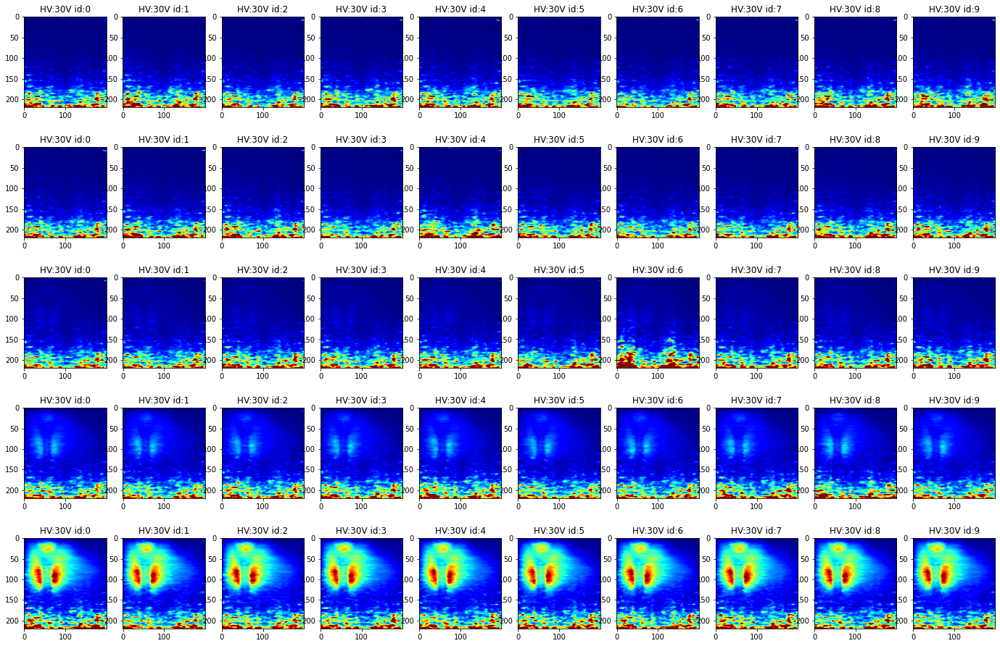

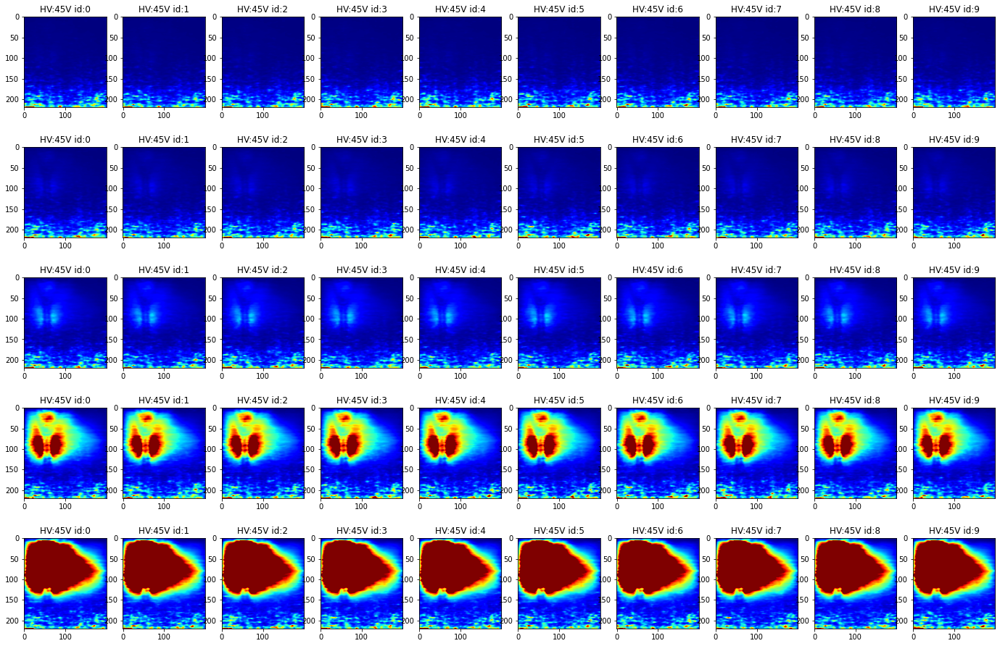

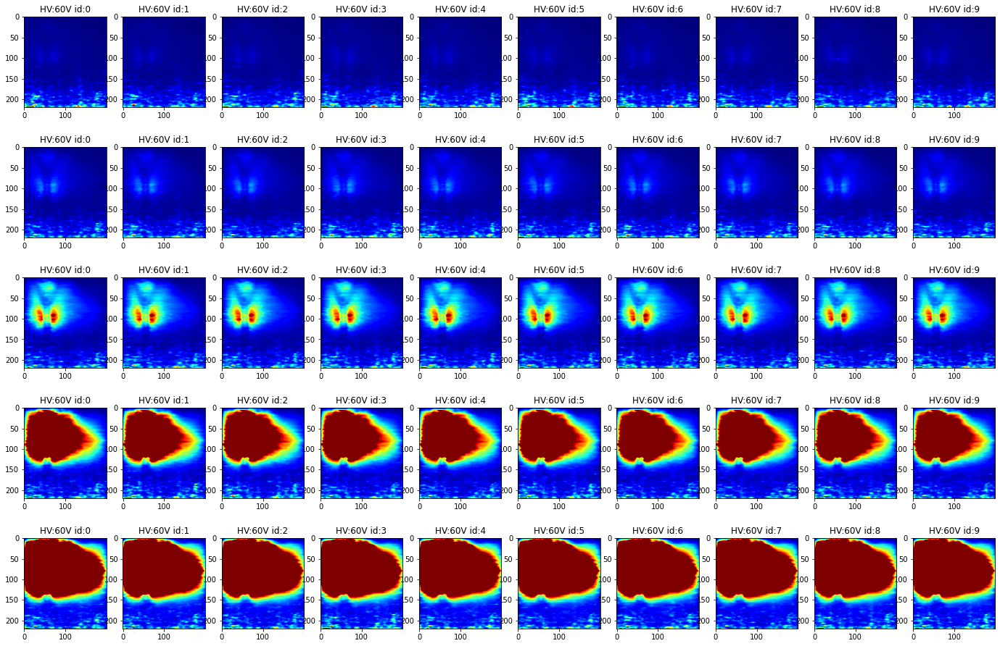

In [19]:
# Load and print SWDF energy maps 
norm = plt.Normalize(0, 1e-5, True)

print('SWDF Energy maps: HV 30V')
fig1, ax1 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[0])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/energy_swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"]  

        pcm=ax1[i][j].imshow(din, cmap='jet', norm=norm)
        ax1[i][j].set_title('HV:30V id:'+idxi)
        
        
        
print('SWDF Energy maps: HV 45V')
fig2, ax2 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[1])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/energy_swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"]  

        pcm=ax2[i][j].imshow(din, cmap='jet', norm=norm)
        ax2[i][j].set_title('HV:45V id:'+idxi)
        
print('SWDF Energy maps: HV 60V')
fig3, ax3 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[2])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/energy_swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"]  

        pcm=ax3[i][j].imshow(din, cmap='jet', norm=norm)
        ax3[i][j].set_title('HV:60V id:'+idxi)        

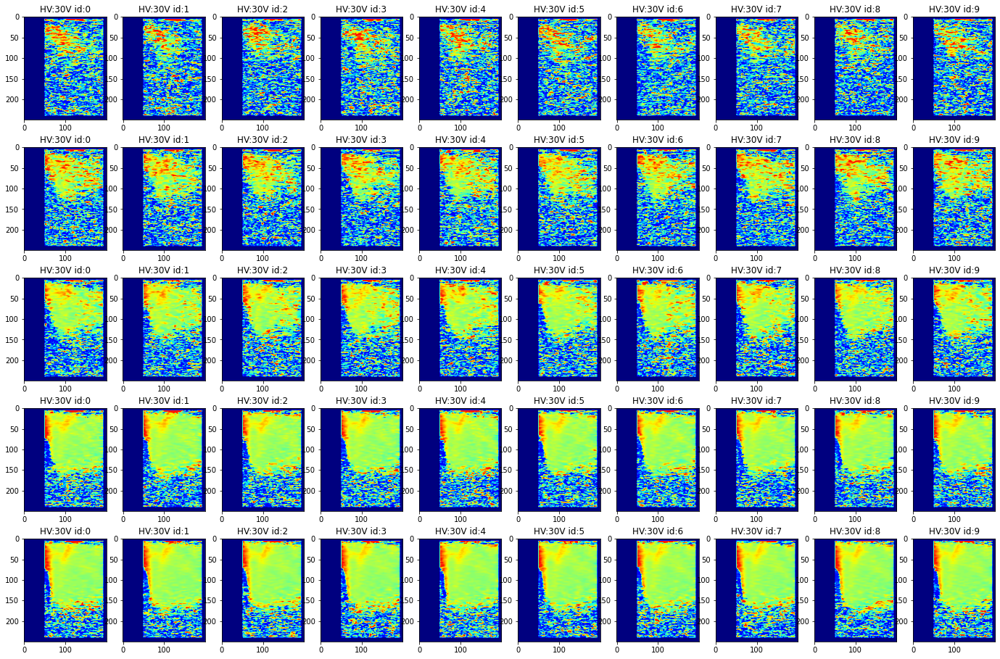

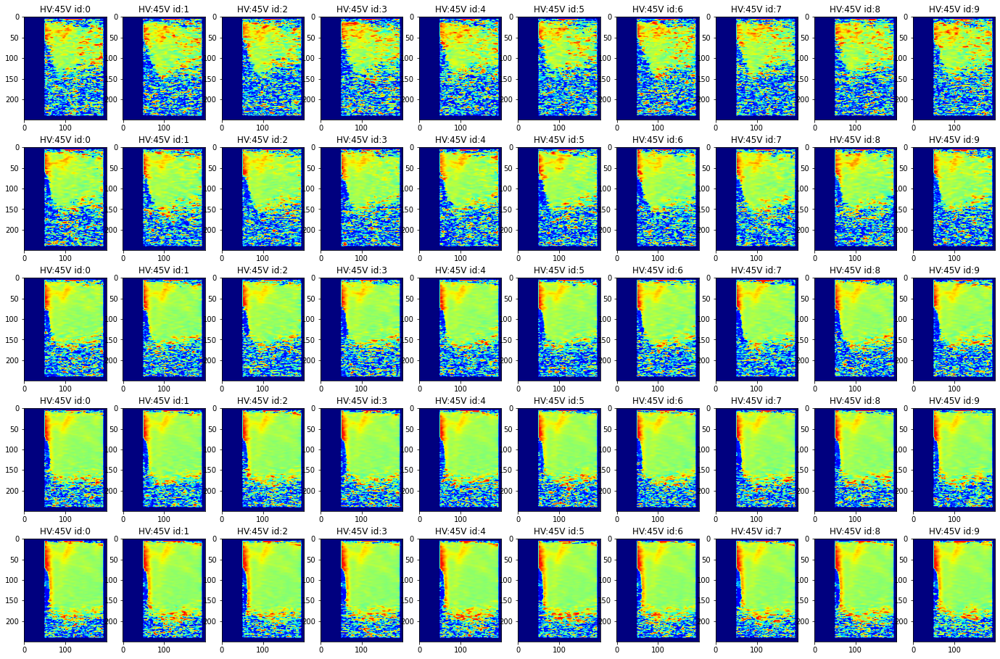

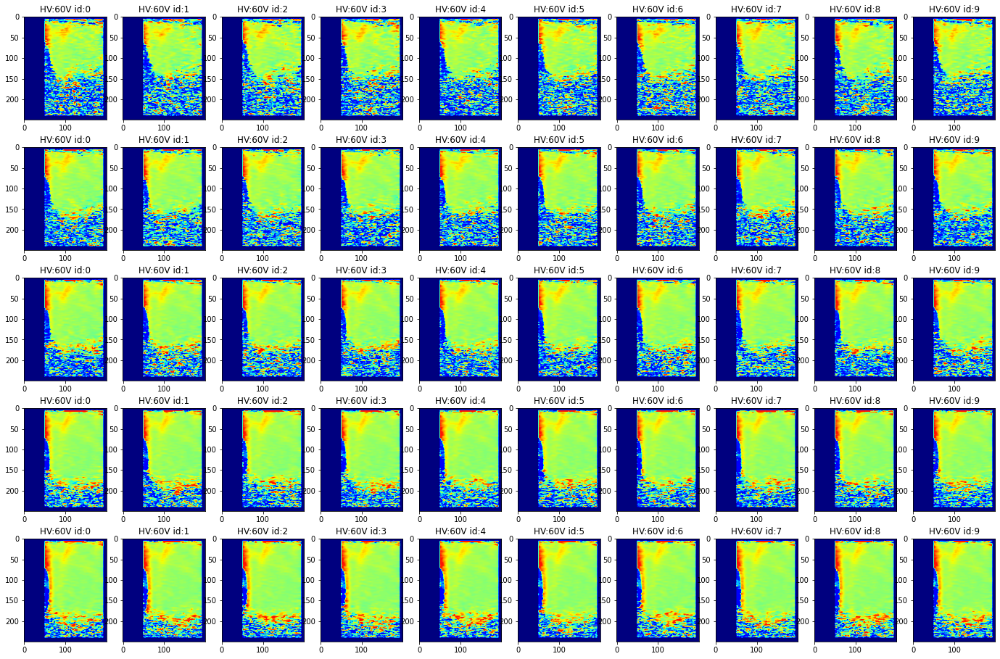

In [20]:
# Load and print SWS maps 
norm = plt.Normalize(0, 4.5, True)

fig1, ax1 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[0])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"] 
        
        sws_maps[0, i, j, ...] = np.squeeze(din[0, 0, ...])
        r_maps[0, i, j, ...]   = np.squeeze(din[1, 0, ...])       

        pcm=ax1[i][j].imshow(np.squeeze(din[0, 0, ...]), cmap='jet', norm=norm)
        ax1[i][j].set_title('HV:30V id:'+idxi)
            
fig2, ax2 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[1])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"] 
        sws_maps[1, i, j, ...] = np.squeeze(din[0, 0, ...])
        r_maps[1, i, j, ...]   = np.squeeze(din[1, 0, ...])       

        pcm=ax2[i][j].imshow(np.squeeze(din[0, 0, ...]), cmap='jet', norm=norm)
        ax2[i][j].set_title('HV:45V id:'+idxi)
        
fig3, ax3 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[2])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"]  
        sws_maps[2, i, j, ...] = np.squeeze(din[0, 0, ...])
        r_maps[2, i, j, ...]   = np.squeeze(din[1, 0, ...])       

        pcm=ax3[i][j].imshow(np.squeeze(din[0, 0, ...]), cmap='jet', norm=norm)
        ax3[i][j].set_title('HV:60V id:'+idxi)        

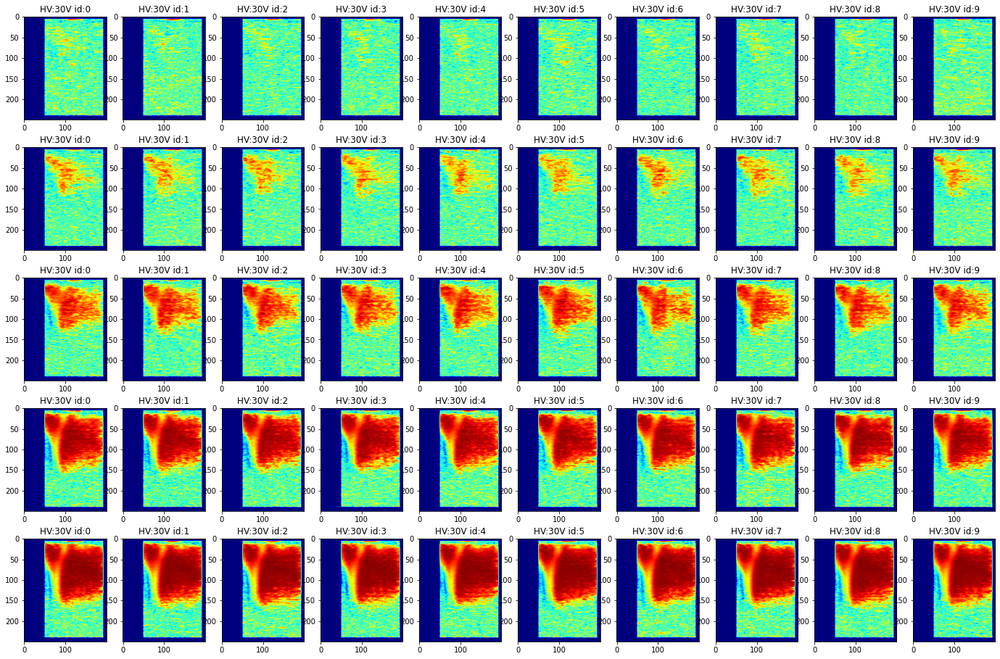

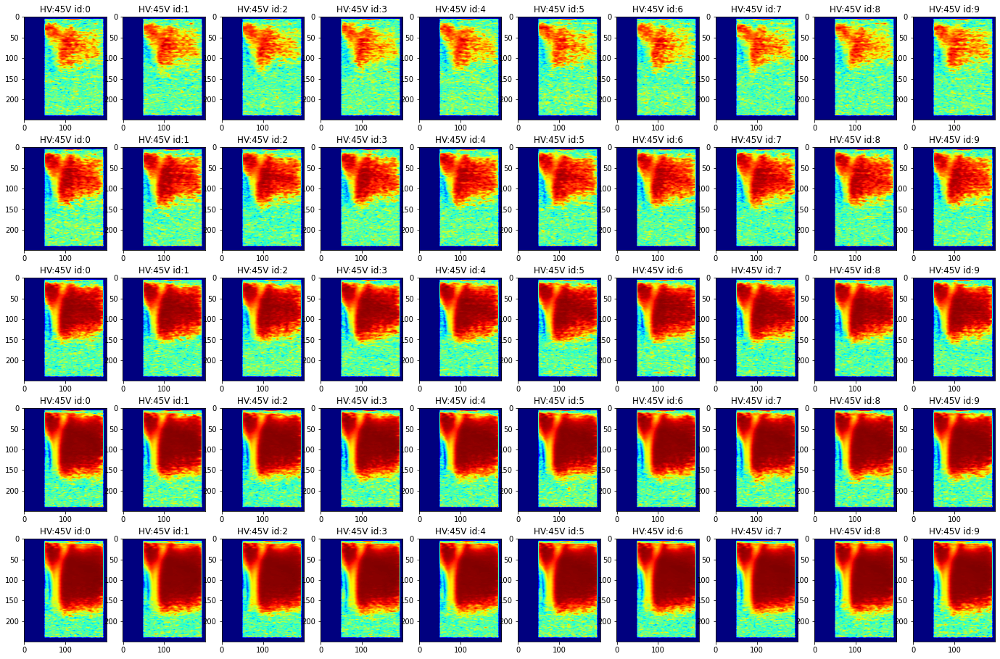

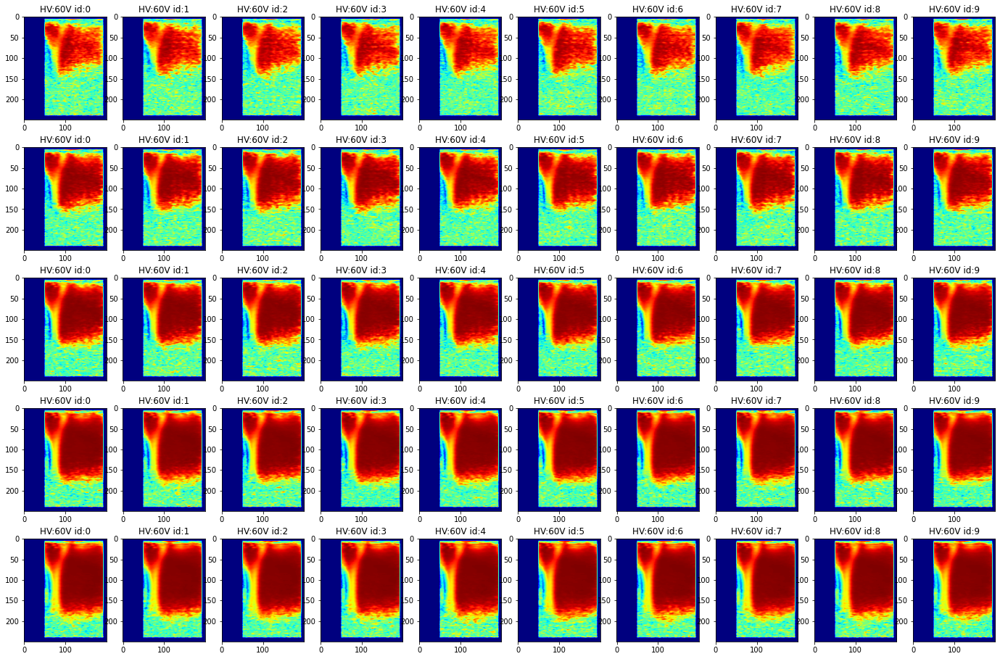

In [21]:
# Load and print R maps 
norm = plt.Normalize(0, 1, True)

fig1, ax1 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[0])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"] 
        din = np.squeeze(din[1, 0, ...])

        pcm=ax1[i][j].imshow(din, cmap='jet', norm=norm)
        ax1[i][j].set_title('HV:30V id:'+idxi)
            
fig2, ax2 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[1])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"] 
        din = np.squeeze(din[1, 0, ...])

        pcm=ax2[i][j].imshow(din, cmap='jet', norm=norm)
        ax2[i][j].set_title('HV:45V id:'+idxi)
        
fig3, ax3 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load
        hvi = str(hv[2])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/sws_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')
        din = dataset["data"]  
        din = np.squeeze(din[1, 0, ...])

        pcm=ax3[i][j].imshow(din, cmap='jet', norm=norm)
        ax3[i][j].set_title('HV:60V id:'+idxi)  

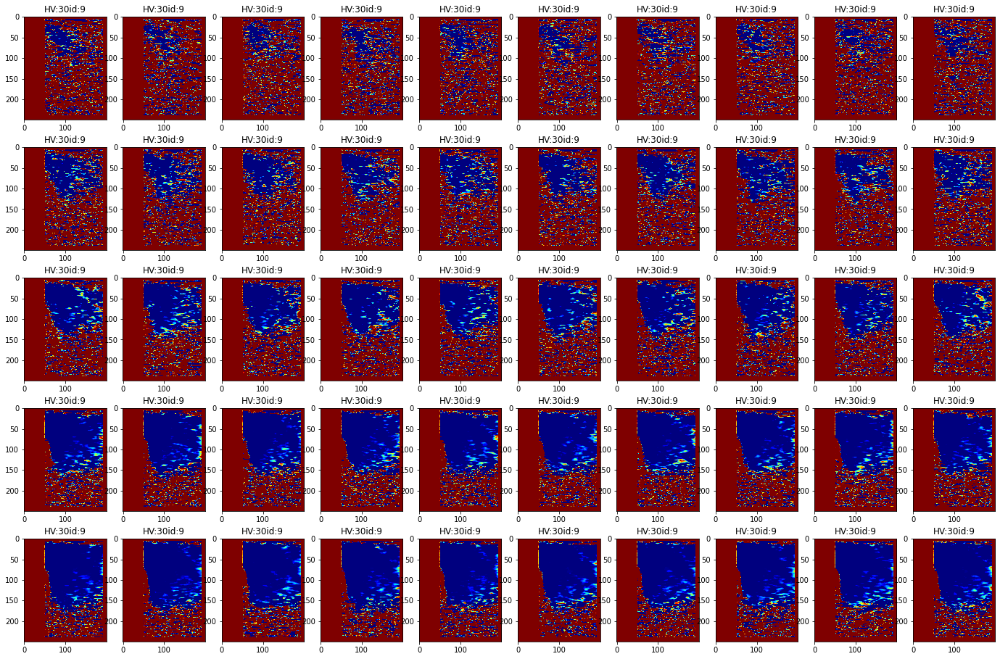

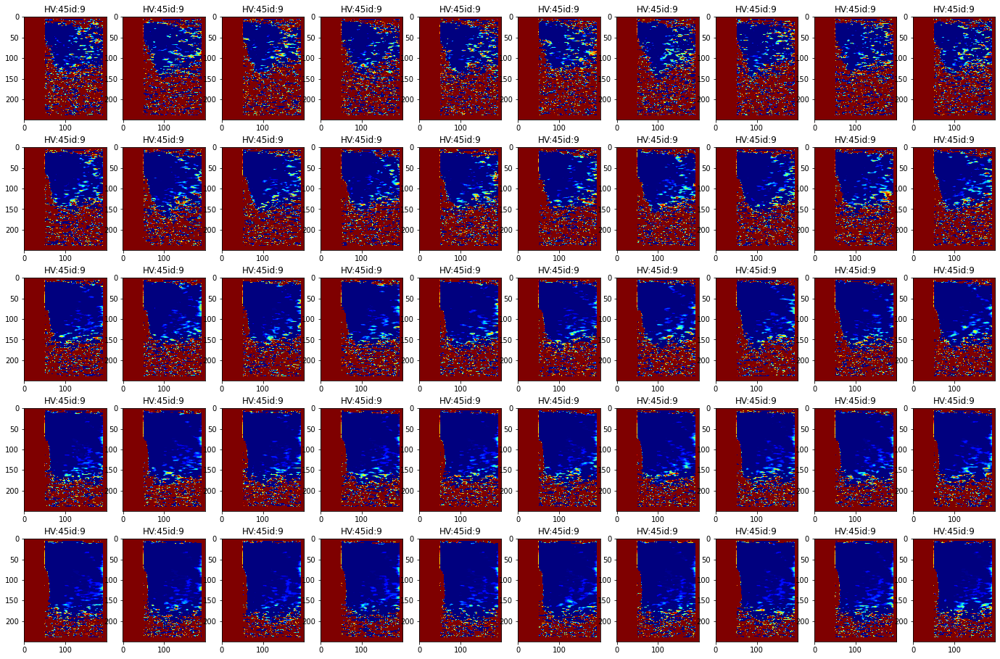

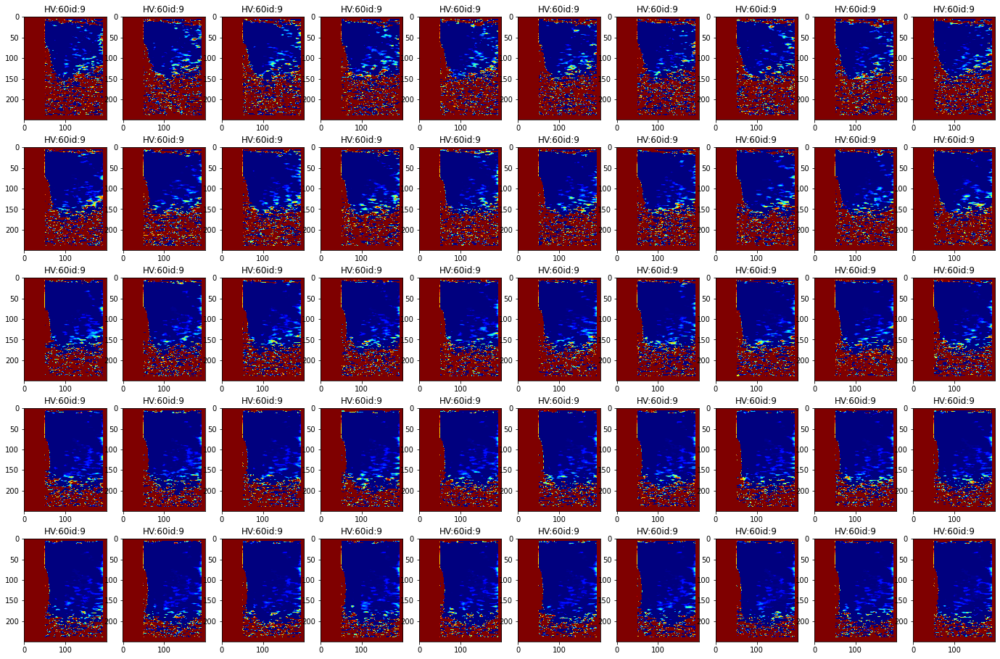

In [22]:
# Find and print bias maps
bias_maps = np.zeros(sws_maps.shape)

norm = plt.Normalize(0, 0.5, True)

bias_maps = np.sqrt(16.7/3.0) - sws_maps

for h in range(len(hv)):
    fig1, ax1 = plt.subplots(len(pblen), len(idx), figsize=(24, 16))
    for i in range(len(pblen)):
        for j in range(len(idx)):
            pcm=ax1[i][j].imshow(np.squeeze(bias_maps[h, i, j, ...]), cmap='jet', norm=norm)
            ax1[i][j].set_title('HV:'+str(hv[h])+ 'id:'+idxi)
            

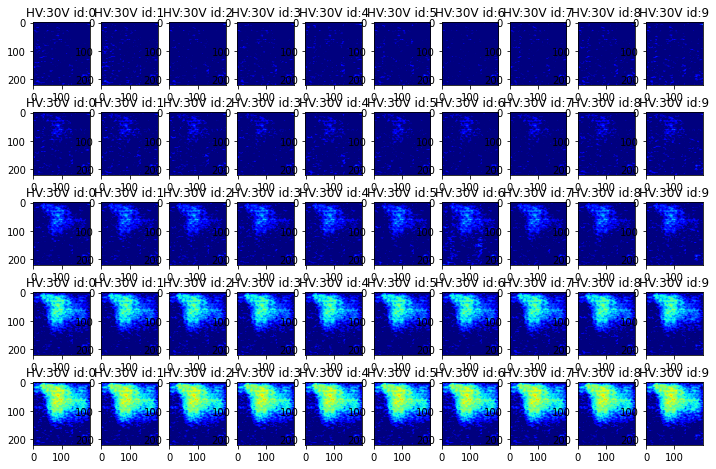

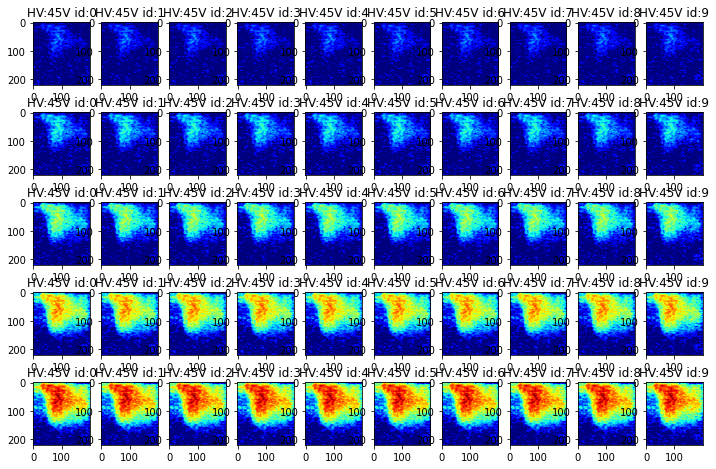

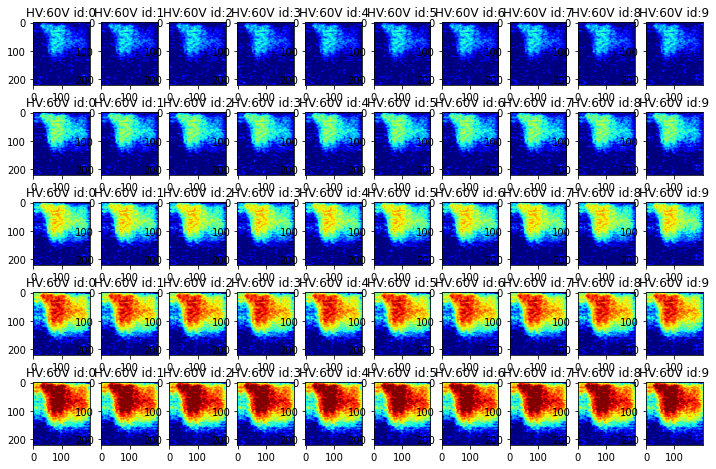

In [23]:
## Find shear wave motion SNR maps ##
noiseIdx = [1, 5, 8]
SNR_maps = np.zeros((len(hv), len(pblen), len(idx), energy_swd_shape[0], energy_swd_shape[1]))

# Find noise energy maps 
noiseE_maps = np.zeros((len(hv), energy_swd_shape[0], energy_swd_shape[1]))

for p in range(len(hv)):
    dataset = sp.io.loadmat(path + '/Test_1/g/swdf' + '_freq4.4' + '_cycles2' + '_pri100.0_id_'+ str(noiseIdx[p])+'.mat')
    swdf = dataset["data"] 
    ddataE1 = cp.asarray(np.squeeze(swdf[0, 10:-20, :, 0:120]))
    m = cp.mean(ddataE1, axis=2)
    ddataE1 = cp.transpose(ddataE1, [2,0,1])
    ddataE1 = cp.subtract(ddataE1, m)
    ddataE1 = cp.transpose(ddataE1, [1,2,0])
    E1 = cp.power(ddataE1, 2)
    E1 = cp.squeeze(np.sum(E1, 2))
    noiseE = E1.get() 
    noiseE_maps[p, ...] = noiseE  
    
# Find and print SNR maps
norm = plt.Normalize(0, 70, True)

fig1, ax1 = plt.subplots(len(pblen), len(idx), figsize=(12, 8))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load SW data
        hvi = str(hv[0])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')       
        swdf = dataset["data"] 
        ddataE1 = cp.asarray(np.squeeze(swdf[0, 10:-20, :, 0:120]))
        m = cp.mean(ddataE1, axis=2)
        ddataE1 = cp.transpose(ddataE1, [2,0,1])
        ddataE1 = cp.subtract(ddataE1, m)
        ddataE1 = cp.transpose(ddataE1, [1,2,0])
        E1 = cp.power(ddataE1, 2)
        E1  = cp.squeeze(np.sum(E1, 2))
        E = E1.get()

        # Calc SNR map and axial profile
        SNRi = E / np.squeeze(noiseE_maps[0, ...])
        SNRi = 20 * np.log10(SNRi)
        
        SNR_maps[0, i, j, ...] = SNRi
        
        pcm=ax1[i][j].imshow(SNRi, cmap='jet', norm=norm)
        ax1[i][j].set_title('HV:30V id:'+idxi)
        
fig2, ax2 = plt.subplots(len(pblen), len(idx), figsize=(12, 8))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load SW data
        hvi = str(hv[1])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')       
        swdf = dataset["data"] 
        ddataE1 = cp.asarray(np.squeeze(swdf[0, 10:-20, :, 0:120]))
        m = cp.mean(ddataE1, axis=2)
        ddataE1 = cp.transpose(ddataE1, [2,0,1])
        ddataE1 = cp.subtract(ddataE1, m)
        ddataE1 = cp.transpose(ddataE1, [1,2,0])
        E1 = cp.power(ddataE1, 2)
        E1  = cp.squeeze(np.sum(E1, 2))
        E = E1.get()

        # Calc SNR map and axial profile
        SNRi = E / np.squeeze(noiseE_maps[1, ...])
        SNRi = 20 * np.log10(SNRi)
        
        SNR_maps[1, i, j, ...] = SNRi
        
        pcm=ax2[i][j].imshow(SNRi, cmap='jet', norm=norm)
        ax2[i][j].set_title('HV:45V id:'+idxi)
        
fig3, ax3 = plt.subplots(len(pblen), len(idx), figsize=(12, 8))
for i in range(len(pblen)):
    for j in range(len(idx)):
        # Load SW data
        hvi = str(hv[2])
        pbleni = str(pblen[i])
        idxi = str(j)
        dataset = sp.io.loadmat(path+'/Test_9/swdf_pblen'+pbleni+'_hv'+hvi+'_id_'+idxi+'.mat')       
        swdf = dataset["data"] 
        ddataE1 = cp.asarray(np.squeeze(swdf[0, 10:-20, :, 0:120]))
        m = cp.mean(ddataE1, axis=2)
        ddataE1 = cp.transpose(ddataE1, [2,0,1])
        ddataE1 = cp.subtract(ddataE1, m)
        ddataE1 = cp.transpose(ddataE1, [1,2,0])
        E1 = cp.power(ddataE1, 2)
        E1  = cp.squeeze(np.sum(E1, 2))
        E = E1.get()

        # Calc SNR map and axial profile
        SNRi = E / np.squeeze(noiseE_maps[2, ...])
        SNRi = 20 * np.log10(SNRi)
        
        SNR_maps[2, i, j, ...] = SNRi
        
        pcm=ax3[i][j].imshow(SNRi, cmap='jet', norm=norm)
        ax3[i][j].set_title('HV:60V id:'+idxi)
                

In [24]:
# Find variance of SWS maps
sws_devs = np.squeeze(np.std(sws_maps, axis=2))
print(sws_devs.shape)

(3, 5, 250, 200)


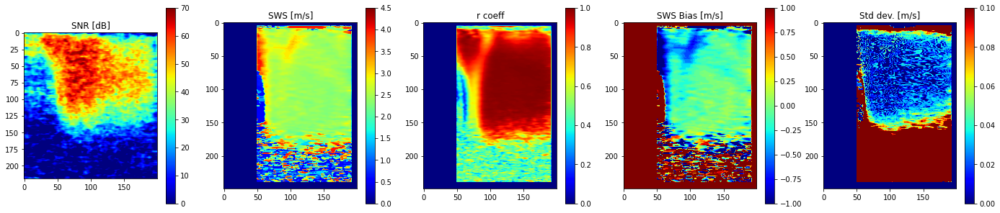

In [25]:
# Load a set of pairing images
hv    = 2
pblen = 3
idx   = 0

norm_snr  = plt.Normalize(0, 70, True)
norm_sws  = plt.Normalize(0, 4.5, True)
norm_bias = plt.Normalize(-1, 1, True)
norm_r    = plt.Normalize(0, 1, True)
norm_devs = plt.Normalize(0, 0.1, True)

fig, ax = plt.subplots(1, 5, figsize=(24, 5))

pcm=ax[0].imshow(SNR_maps[hv, pblen, idx, ...], cmap='jet', norm=norm_snr)
ax[0].set_title('SNR [dB]')
fig.colorbar(pcm, ax=ax[0])

pcm=ax[1].imshow(sws_maps[hv, pblen, idx, ...], cmap='jet', norm=norm_sws)
ax[1].set_title('SWS [m/s]')
fig.colorbar(pcm, ax=ax[1])

pcm=ax[2].imshow(r_maps[hv, pblen, idx, ...], cmap='jet', norm=norm_r)
ax[2].set_title('r coeff')
fig.colorbar(pcm, ax=ax[2])

pcm=ax[3].imshow(bias_maps[hv, pblen, idx, ...], cmap='jet', norm=norm_bias)
ax[3].set_title('SWS Bias [m/s]')
fig.colorbar(pcm, ax=ax[3])

pcm=ax[4].imshow(sws_devs[hv, pblen, ...], cmap='jet', norm=norm_devs)
ax[4].set_title('Std dev. [m/s]')
fig.colorbar(pcm, ax=ax[4])

#sws_maps = np.zeros((len(hv), len(pblen), len(idx), sws_shape[2], sws_shape[3]))
#sws_devs = np.zeros((len(hv), len(pblen), sws_shape[2], sws_shape[3]))
#SNR_maps = np.zeros((len(hv), len(pblen), len(idx), energy_swd_shape[0], energy_swd_shape[1]))
#r_maps   = np.zeros((len(hv), len(pblen), len(idx), sws_shape[2], sws_shape[3]))

(218, 191)
(218, 191)
(178, 140)
(178, 140)
(24920,)
(24920,)


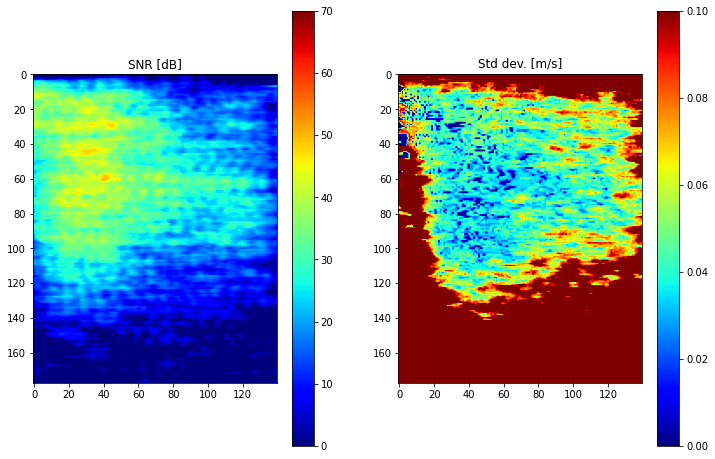

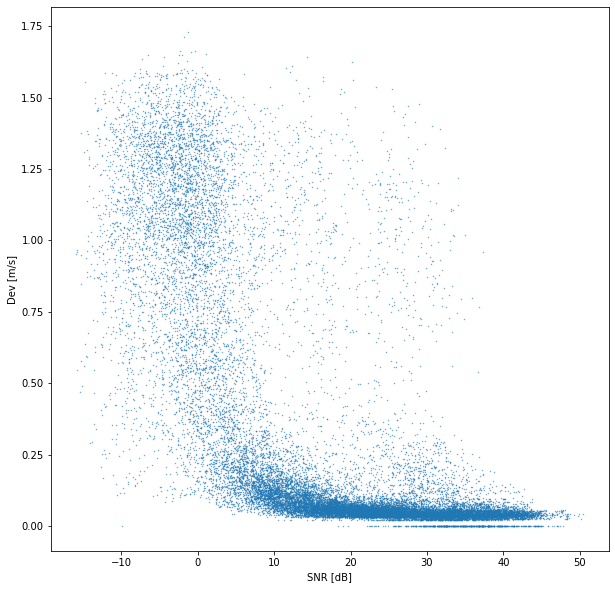

In [34]:
# SNR - std_dev scatter plot
hv    = 0 # {30, 45, 60}
pblen = 4 #[25, 50, 100, 250, 500]
idx   = 2

snr_s1 = SNR_maps[hv, pblen, :, 1:-1, :-9]
snr_s2 = SNR_maps[hv, pblen, :, 1:-1, 9:]
snr_s1 = np.mean(snr_s1, axis=0)
snr_s2 = np.mean(snr_s2, axis=0)
snr_s = 0.5 * (snr_s1 + snr_s2)
print(snr_s1.shape)
print(snr_s2.shape)

snr_s = snr_s[:-40, 51:]
print(snr_s.shape)
swsdev_s = sws_devs[hv, pblen, 11:-21-40, 50:-10]
print(swsdev_s.shape)

if(1):
    # 2D plots
    fig, ax = plt.subplots(1,2,figsize=(12, 8))

    pcm=ax[0].imshow(snr_s, cmap='jet', norm=norm_snr)
    ax[0].set_title('SNR [dB]')
    fig.colorbar(pcm, ax=ax[0])

    pcm=ax[1].imshow(swsdev_s, cmap='jet', norm=norm_devs)
    ax[1].set_title('Std dev. [m/s]')
    fig.colorbar(pcm, ax=ax[1])


    # Scatter plot
    snr_sf = snr_s.flatten()
    swsdev_sf = swsdev_s.flatten()
    print(snr_sf.shape)
    print(swsdev_sf.shape)

    fig, ax = plt.subplots(1,1,figsize=(10, 10))
    ax.scatter(snr_sf, swsdev_sf, s=0.2, alpha=0.7)
    ax.set_xlabel("SNR [dB]")
    ax.set_ylabel("Dev [m/s]")
    #plt.show()
    
    if(0):
        # Fit the regression line
        z = np.polyfit(snr_sf, swsdev_sf, deg=20)
        p = np.poly1d(z)

        # Create sequence of 100 numbers from 0 to 100 
        xseq = np.linspace(0, 60, num=100)

        # Plot regression line
        ax.plot(xseq, p(xseq), color="k", lw=2.5);

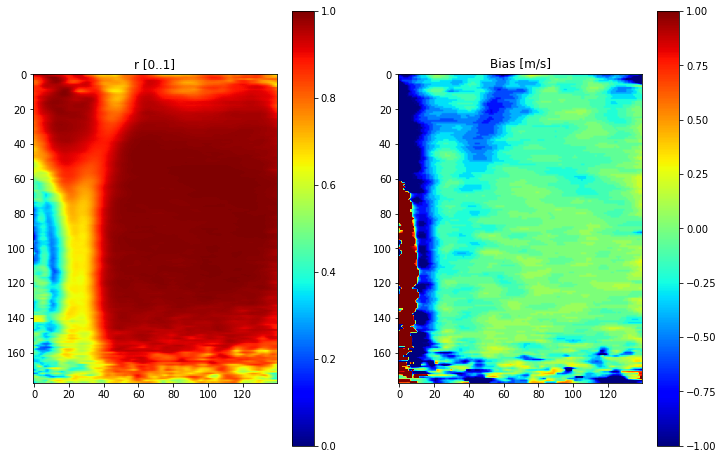

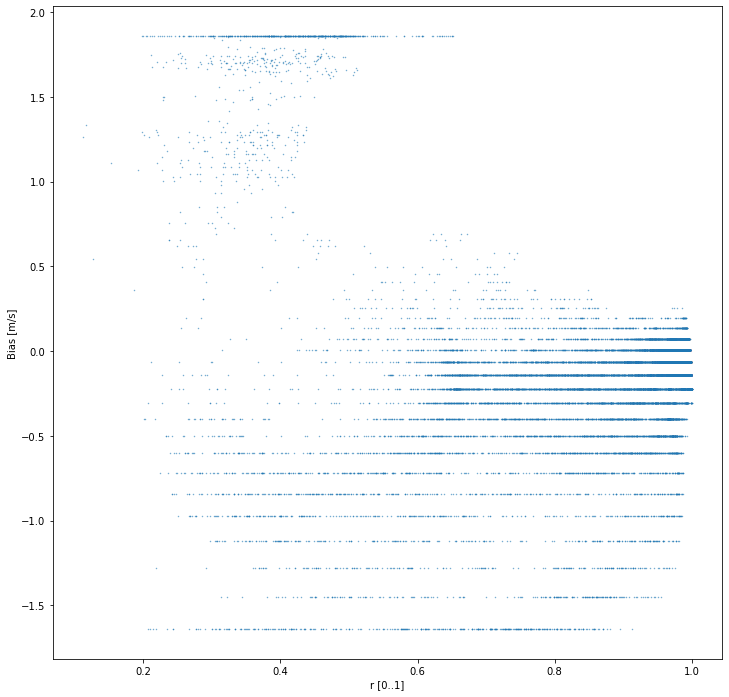

In [27]:
# Bias - R-coeff
hv    = 2
pblen = 4 #[25, 50, 100, 250, 500]
idx   = 1

#snr_s = SNR_maps[hv, pblen, idx, 1:-1, 55:-11]

r_s    = np.squeeze(r_maps[hv, pblen, idx, 11:-21-40, 50:-10])
bias_s = np.squeeze(bias_maps[hv, pblen, idx, 11:-21-40, 50:-10])

if(1):
    # 2D plots
    fig, ax = plt.subplots(1,2,figsize=(12, 8))

    pcm=ax[0].imshow(r_s, cmap='jet', norm=norm_r)
    ax[0].set_title('r [0..1]')
    fig.colorbar(pcm, ax=ax[0])

    pcm=ax[1].imshow(bias_s, cmap='jet', norm=norm_bias)
    ax[1].set_title('Bias [m/s]')
    fig.colorbar(pcm, ax=ax[1])

    # Scatter plot
    r_s = r_s.flatten()
    bias_s = bias_s.flatten()

    fig, ax = plt.subplots(1,1,figsize=(12, 12))
    ax.scatter(r_s, bias_s, s=0.2, alpha=0.7)
    ax.set_xlabel("r [0..1]")
    ax.set_ylabel("Bias [m/s]")
    #plt.show()
    